# Problem Statement
What are the key characteristics of tennis players who win, especially in very close matches that last for up five sets? 
Also, is it possible to create a model that is better at predicting the winner than simply using the official ATP ranking?

In [1]:
import pandas as pd
import re
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.dummy import DummyClassifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import recall_score
from time import process_time
import time

In [2]:
# Load the ATP match data from Kaggle (https://www.kaggle.com/datasets/sijovm/atpdata/data)
df=pd.read_csv(r'C:\Users\fc_pe\OneDrive\Documents\Professional Development\Berkeley Professional Certificate in ML and AI\Capstone Project\atp_matches_till_2022.csv')

In [3]:
df_slice=df.iloc[0:18,20:30]
df_slice.head()

,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt
0,NaN,UNK,24.0,6-1 7-5,3,R32,NaN,NaN,NaN,NaN
1,NaN,IRL,NaN,6-1 6-1,3,R32,NaN,NaN,NaN,NaN
2,NaN,IRL,NaN,6-2 6-2,3,R32,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,6-1 6-1,3,R32,NaN,NaN,NaN,NaN
4,NaN,IRL,NaN,6-2 6-4,3,R32,NaN,NaN,NaN,NaN


In [4]:
df.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
0,1968-2029,Dublin,Grass,32,A,19680708,270,112411,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1968-2029,Dublin,Grass,32,A,19680708,271,126914,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1968-2029,Dublin,Grass,32,A,19680708,272,209523,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1968-2029,Dublin,Grass,32,A,19680708,273,100084,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1968-2029,Dublin,Grass,32,A,19680708,274,100132,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
df['score']

0                 6-1 7-5
1                 6-1 6-1
2                 6-2 6-2
3                 6-1 6-1
4                 6-2 6-4
               ...       
188156            6-4 6-4
188157        4-6 6-4 6-4
188158    1-6 6-4 4-1 RET
188159            6-4 6-4
188160            6-4 6-4
Name: score, Length: 188161, dtype: object

In [6]:
# Check distribution of right and left handed players
df['winner_hand'].value_counts()

winner_hand
R    158958
L     27205
U      1981
Name: count, dtype: int64

In [7]:
# Consider encoding R=1, L=-1, and U=0
df['loser_hand'].value_counts()

loser_hand
R    157351
L     24847
U      5899
Name: count, dtype: int64

In [8]:
df['surface'].value_counts()

surface
Hard      74810
Clay      67428
Grass     22841
Carpet    20765
Name: count, dtype: int64

In [17]:
# Create function that counts number of sets in a score
def count_sets(x):
#    x1=x.to_string() # new line of code
    length=len(x)
    sets=0
    for i in range(0,length):
        if x[i]=='-':
            sets=sets+1
    return sets
    


In [18]:
# Calculate number of sets in a score
n_sets=count_sets('6-7(5) 7-6(5) 7-6(4) 3-6 7-5')
print(n_sets)

5


In [19]:
# Create functions that counts number of sets for winner and loser
def w_sets(n_sets,best_of):
    w_sets=n_sets
    if ((n_sets==2) & (best_of==3)):
        w_sets=2
    if ((n_sets==3) & (best_of==3)):
        w_sets=2
    if ((n_sets==3) & (best_of==5)):
        w_sets=3
    if ((n_sets==4) & (best_of==5)):
        w_sets=3
    if ((n_sets==5) & (best_of==5)):
        w_sets=3
    return w_sets

def l_sets(n_sets,best_of):
    l_sets=0
    if ((n_sets==2) & (best_of==3)):
        l_sets=0
    if ((n_sets==3) & (best_of==3)):
        l_sets=1
    if ((n_sets==3) & (best_of==5)):
        l_sets=0
    if ((n_sets==4) & (best_of==5)):
        l_sets=1
    if ((n_sets==5) & (best_of==5)):
        l_sets=2
    return l_sets

In [20]:
print(w_sets(3,5))

3


In [21]:
print(l_sets(2,3))

0


In [22]:
# Check how Python handles names based on alphabetical order - will be used later for Player A and Player B
if ('Rafael Nadal'>'Novak Djokovic'):
    print('Player B is:','Rafael Nadal')

Player B is: Rafael Nadal


In [23]:
# Create dataframe df1 containing matches from January 1, 2010 - limit the study to matches played in relatively modern time
df1=df[df['tourney_date']>=20100000]


In [24]:
df1.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points
151652,2010-339,Brisbane,Hard,32,A,20100103,1,104053,1.0,NaN,...,34.0,29.0,11.0,10.0,3.0,5.0,7.0,4410.0,77.0,598.0
151653,2010-339,Brisbane,Hard,32,A,20100103,2,104958,NaN,WC,...,34.0,22.0,14.0,9.0,7.0,10.0,134.0,400.0,78.0,590.0
151654,2010-339,Brisbane,Hard,32,A,20100103,3,104755,NaN,NaN,...,58.0,38.0,14.0,14.0,7.0,11.0,52.0,850.0,88.0,568.0
151655,2010-339,Brisbane,Hard,32,A,20100103,4,105051,NaN,Q,...,29.0,16.0,15.0,9.0,2.0,5.0,285.0,151.0,28.0,1260.0
151656,2010-339,Brisbane,Hard,32,A,20100103,5,104607,4.0,NaN,...,41.0,26.0,14.0,9.0,6.0,9.0,20.0,1655.0,251.0,179.0


In [25]:
# Check distribution of different surfaces
df1['surface'].value_counts()

surface
Hard      21320
Clay      11261
Grass      3862
Carpet       66
Name: count, dtype: int64

In [26]:
df1['tourney_level'].value_counts()

tourney_level
A    19696
M     6858
G     6477
D     3236
F      242
Name: count, dtype: int64

In [27]:
# Remove matches played on carpet (surface type removed from 2009)
df2=df1[df1['surface']!='Carpet']

In [28]:
df2['surface'].value_counts()

surface
Hard     21320
Clay     11261
Grass     3862
Name: count, dtype: int64

In [29]:
# Encode 'surface' as Grass=1, Hard=0, and Clay=-1 (the higher the number, the faster the surface)
df3=df2.replace(to_replace=['Grass','Hard','Clay'],value=[1,0,-1])

In [30]:
df3['surface'].value_counts()

surface
 0    21320
-1    11261
 1     3862
Name: count, dtype: int64

In [31]:
# Add new columns 'Player A' and 'Player B' where Player A's name comes before Player B's name in alphabetical order
df3['Player A']=df3[['winner_name','loser_name']].min(axis=1)
df3['Player B']=df3[['winner_name','loser_name']].max(axis=1)

In [32]:
df3.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B
151652,2010-339,Brisbane,0,32,A,20100103,1,104053,1.0,NaN,...,11.0,10.0,3.0,5.0,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak
151653,2010-339,Brisbane,0,32,A,20100103,2,104958,NaN,WC,...,14.0,9.0,7.0,10.0,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev
151654,2010-339,Brisbane,0,32,A,20100103,3,104755,NaN,NaN,...,14.0,14.0,7.0,11.0,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet
151655,2010-339,Brisbane,0,32,A,20100103,4,105051,NaN,Q,...,15.0,9.0,2.0,5.0,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden
151656,2010-339,Brisbane,0,32,A,20100103,5,104607,4.0,NaN,...,14.0,9.0,6.0,9.0,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych


In [33]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
Index: 36443 entries, 151652 to 188160
Data columns (total 51 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   tourney_id          36443 non-null  object 
 1   tourney_name        36443 non-null  object 
 2   surface             36443 non-null  int64  
 3   draw_size           36443 non-null  int64  
 4   tourney_level       36443 non-null  object 
 5   tourney_date        36443 non-null  int64  
 6   match_num           36443 non-null  int64  
 7   winner_id           36443 non-null  int64  
 8   winner_seed         15622 non-null  float64
 9   winner_entry        4718 non-null   object 
 10  winner_name         36443 non-null  object 
 11  winner_hand         36432 non-null  object 
 12  winner_ht           35887 non-null  float64
 13  winner_ioc          36443 non-null  object 
 14  winner_age          36440 non-null  float64
 15  loser_id            36443 non-null  int64  
 16  los

In [34]:
# Check distribution of tournament rounds
df3['round'].value_counts()

round
R32     11272
R16      6456
R64      5301
R128     4032
RR       3642
QF       3236
SF       1662
F         837
BR          5
Name: count, dtype: int64

In [35]:
df3.shape

(36443, 51)

In [36]:
# Remove matches played in Round Robin (RR) and BR formats
df4=df3[(df3['round']!='RR') & (df3['round']!='BR')]

In [37]:
df4['round'].value_counts()

round
R32     11272
R16      6456
R64      5301
R128     4032
QF       3236
SF       1662
F         837
Name: count, dtype: int64

In [38]:
df4.shape

(32796, 51)

In [39]:
# Replace categories in 'round' with values R128=0, R64=1, R32=2, R16=3, QF=4, SF=5, F=6
df5=df4.copy()
df5['round'].replace(to_replace=['R128','R64','R32','R16','QF','SF','F'],value=[0,1,2,3,4,5,6],inplace=True)

In [40]:
df5['round'].value_counts()

round
2    11272
3     6456
1     5301
0     4032
4     3236
5     1662
6      837
Name: count, dtype: int64

In [41]:
df5.iloc[:,25:45]

,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
151652,2,84.0,15.0,0.0,63.0,42.0,36.0,14.0,10.0,3.0,3.0,4.0,2.0,56.0,34.0,29.0,11.0,10.0,3.0,5.0
151653,2,70.0,10.0,3.0,57.0,30.0,23.0,19.0,10.0,0.0,0.0,2.0,2.0,66.0,34.0,22.0,14.0,9.0,7.0,10.0
151654,2,121.0,5.0,4.0,97.0,51.0,33.0,27.0,15.0,5.0,8.0,4.0,0.0,85.0,58.0,38.0,14.0,14.0,7.0,11.0
151655,2,64.0,12.0,1.0,50.0,35.0,30.0,12.0,10.0,3.0,3.0,2.0,1.0,53.0,29.0,16.0,15.0,9.0,2.0,5.0
151656,2,69.0,3.0,1.0,46.0,27.0,24.0,14.0,9.0,1.0,1.0,6.0,1.0,69.0,41.0,26.0,14.0,9.0,6.0,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187924,5,99.0,10.0,0.0,66.0,50.0,42.0,8.0,11.0,1.0,2.0,15.0,5.0,88.0,66.0,45.0,9.0,12.0,5.0,6.0
187925,5,82.0,4.0,1.0,69.0,47.0,36.0,14.0,12.0,1.0,2.0,2.0,0.0,62.0,40.0,30.0,10.0,10.0,2.0,4.0
187938,6,92.0,9.0,0.0,55.0,39.0,33.0,11.0,11.0,0.0,0.0,6.0,1.0,57.0,40.0,31.0,6.0,10.0,3.0,5.0
187939,5,68.0,10.0,0.0,46.0,35.0,27.0,8.0,9.0,0.0,1.0,9.0,0.0,50.0,30.0,20.0,9.0,9.0,0.0,4.0


In [42]:
# Check matches played by player ID 104745 - Rafael Nadal
print(df5[df5['loser_id']==104745])

       tourney_id          tourney_name  surface  draw_size tourney_level  \
151744   2010-451                  Doha        0         32             A   
151922   2010-580       Australian Open        0        128             G   
152523   2010-404  Indian Wells Masters        0         96             M   
152618   2010-403         Miami Masters        0         96             M   
153258   2010-311          Queen's Club        1         56             A   
...           ...                   ...      ...        ...           ...   
186391  2022-0416          Rome Masters       -1         64             M   
186913   2022-540             Wimbledon        1        128             G   
187267  2022-0422    Cincinnati Masters        0         64             M   
187458   2022-560               Us Open        0        128             G   
187898  2022-0352         Paris Masters        0         64             M   

        tourney_date  match_num  winner_id  winner_seed winner_entry  ...  

In [43]:
df5['tourney_level'].value_counts()

tourney_level
A    19413
M     6858
G     6477
F       48
Name: count, dtype: int64

In [44]:
# Replace 'tourney_level' categories with F=0, A=1, M=2, and G=3
d6=df5.copy()
d6['tourney_level'].replace(to_replace=['F','A','M','G'],value=[0,1,2,3],inplace=True)

In [45]:
d6['tourney_level'].value_counts()

tourney_level
1    19413
2     6858
3     6477
0       48
Name: count, dtype: int64

In [46]:
# Subtract 20,000,000 to convert from YYYYMMDD format to YYMMDD format and then take the logarithm to reduce number size
d6['log tourney_date']=np.log10(d6['tourney_date']-20000000)

In [47]:
d6.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,10.0,3.0,5.0,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,9.0,7.0,10.0,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,14.0,7.0,11.0,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,9.0,2.0,5.0,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,9.0,6.0,9.0,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447


In [48]:
d6['winner_hand'].value_counts()

winner_hand
R    28310
L     4448
U       38
Name: count, dtype: int64

In [49]:
d6['loser_hand'].value_counts()

loser_hand
R    27931
L     4725
U      140
Name: count, dtype: int64

In [50]:
# Encode 'winner_hand' and 'loser_hand' categories as R=1, U=0, and L=-1
d7=d6.copy()
d7['winner_hand'].replace(to_replace=['R','U','L'],value=[1,0,-1],inplace=True)
d7['loser_hand'].replace(to_replace=['R','U','L'],value=[1,0,-1],inplace=True)

In [51]:
d7['winner_hand'].value_counts()

winner_hand
 1    28310
-1     4448
 0       38
Name: count, dtype: int64

In [52]:
d7['loser_hand'].value_counts()

loser_hand
 1    27931
-1     4725
 0      140
Name: count, dtype: int64

In [53]:
d7.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,10.0,3.0,5.0,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,9.0,7.0,10.0,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,14.0,7.0,11.0,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,9.0,2.0,5.0,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,9.0,6.0,9.0,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447


In [54]:
# Create 'Player A ID' and 'Player B ID' features that correspond to the 'Player A' and 'Player B' features.
# Player A and Player B are in alphabetical order and will be used together with a target feature "winner"
# that will be created below for the training of the different models as the original dataset lacks a target feature.
d7['Player A ID']=np.where(d7['Player A']==d7['winner_name'],d7['winner_id'],d7['loser_id'])
d7['Player B ID']=np.where(d7['Player B']==d7['winner_name'],d7['winner_id'],d7['loser_id'])

In [55]:
d7.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,5.0,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,10.0,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,11.0,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,5.0,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,9.0,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607


In [56]:
# Create target feature 'winner', which is either 'A' or 'B', corresponding to Player A and Player B, respectively
d7['winner']=np.where(d7['Player A']==d7['winner_name'],'A','B')

In [57]:
d7.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B


In [58]:
d7.iloc[:,22:55]

,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,...,winner_rank,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner
151652,30.3,7-6(5) 6-2,3,2,84.0,15.0,0.0,63.0,42.0,36.0,...,7.0,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A
151653,22.3,7-5 6-1,3,2,70.0,10.0,3.0,57.0,30.0,23.0,...,134.0,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A
151654,28.4,6-3 4-6 6-4,3,2,121.0,5.0,4.0,97.0,51.0,33.0,...,52.0,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B
151655,28.6,7-5 6-1,3,2,64.0,12.0,1.0,50.0,35.0,30.0,...,285.0,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B
151656,21.4,6-2 6-4,3,2,69.0,3.0,1.0,46.0,27.0,24.0,...,20.0,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187924,20.8,4-3(6) 1-4 4-2 4-3(5),5,5,99.0,10.0,0.0,66.0,50.0,42.0,...,49.0,927.0,41.0,1020.0,Brandon Nakashima,Jack Draper,5.344602,206909,207733,A
187925,20.2,4-1 4-3(4) 2-4 4-1,5,5,82.0,4.0,1.0,69.0,47.0,36.0,...,74.0,715.0,111.0,497.0,Dominic Stricker,Jiri Lehecka,5.344602,208502,208103,B
187938,23.8,7-5 6-3,3,6,92.0,9.0,0.0,55.0,39.0,33.0,...,8.0,3320.0,4.0,5020.0,Casper Ruud,Novak Djokovic,5.344616,134770,104925,B
187939,25.0,6-2 6-4,3,5,68.0,10.0,0.0,46.0,35.0,27.0,...,4.0,5020.0,7.0,3530.0,Andrey Rublev,Casper Ruud,5.344616,126094,134770,B


In [59]:
# Create new column containing number of sets: 'n_sets'
d7['n_sets']=d7['score'].apply(count_sets)

In [60]:
d7['n_sets']

151652    2
151653    2
151654    3
151655    2
151656    2
         ..
187924    4
187925    4
187938    2
187939    2
187940    2
Name: n_sets, Length: 32796, dtype: int64

In [61]:
d7.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,winner_rank_points,loser_rank,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,4410.0,77.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A,2
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,400.0,78.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A,2
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,850.0,88.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B,3
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,151.0,28.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B,2
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,1655.0,251.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B,2


In [62]:
d7.shape

(32796, 56)

In [63]:
# Create function that checks the last three characters of 'score' for 'RET' (meaning a player retired)
def score_ends_with_RET(x):
    return x[-3:]=='RET'

#print(score_ends_with_RET('4-6 6-4 7-6(1) RET'))

# Remove all matches where a player retired
d8=d7[d7['score'].apply(score_ends_with_RET)==False]

In [64]:
d8.shape

(31804, 56)

In [65]:
# Remove rows where 'score'=='W/O' - Walkover
d9=d8[d8['score']!='W/O']

In [66]:
d9.shape

(31652, 56)

In [67]:
d9.shape[0]

31652

In [68]:
# Create two new columns with number of sets that the winner and the loser won: 'w_sets' and 'l_sets'
# w_sets and l_sets were intended to be used in an earlier version for a feature '121idx' that was later discarded as it was found to not be effective
d9['w_sets']=d9.apply(lambda x: w_sets(x['n_sets'],x['best_of']),axis=1)
d9['l_sets']=d9.apply(lambda x: l_sets(x['n_sets'],x['best_of']),axis=1)

C:\Users\fc_pe\AppData\Local\Temp\ipykernel_21340\1012529198.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d9['w_sets']=d9.apply(lambda x: w_sets(x['n_sets'],x['best_of']),axis=1)
C:\Users\fc_pe\AppData\Local\Temp\ipykernel_21340\1012529198.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d9['l_sets']=d9.apply(lambda x: l_sets(x['n_sets'],x['best_of']),axis=1)


In [69]:
d9.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A,2,2,0
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A,2,2,0
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B,3,2,1
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B,2,2,0
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B,2,2,0


In [70]:
# Create function decimal_year that converts date in YYYYMMDD format to a year with a decimal based on month of the year
def decimal_year(date):
    date=date/10000
    year,decimal=divmod(date,1)
    month=round(decimal*100)
    return year+month/12
    
# Test decimal_year function
print(decimal_year(20210930))

2021.75


In [71]:
d9.shape[0]

31652

In [74]:
d99=d9.iloc[0:1000]

In [75]:
d99.shape

(1000, 58)

In [76]:
d99.tail()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
152831,2010-416,Rome Masters,-1,56,2,20100425,48,104925,2.0,NaN,...,1402.0,Novak Djokovic,Thomaz Bellucci,5.001842,104925,105064,A,2,2,0
152832,2010-416,Rome Masters,-1,56,2,20100425,49,105208,NaN,NaN,...,1205.0,Ernests Gulbis,Feliciano Lopez,5.001842,105208,103852,A,2,2,0
152833,2010-416,Rome Masters,-1,56,2,20100425,50,104745,3.0,NaN,...,1510.0,Rafael Nadal,Stan Wawrinka,5.001842,104745,104527,A,2,2,0
152834,2010-416,Rome Masters,-1,56,2,20100425,51,103970,13.0,NaN,...,3050.0,David Ferrer,Jo-Wilfried Tsonga,5.001842,103970,104542,A,2,2,0
152835,2010-416,Rome Masters,-1,56,2,20100425,52,104269,6.0,NaN,...,7390.0,Fernando Verdasco,Novak Djokovic,5.001842,104269,104925,A,3,2,1


In [77]:
# Include ALL matches starting from 2010
d10=d9.copy()

In [78]:
d10.tail()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
187924,2022-7696,NextGen Finals,0,8,1,20221107,299,206909,4.0,NaN,...,1020.0,Brandon Nakashima,Jack Draper,5.344602,206909,207733,A,4,3,1
187925,2022-7696,NextGen Finals,0,8,1,20221107,298,208103,5.0,NaN,...,497.0,Dominic Stricker,Jiri Lehecka,5.344602,208502,208103,B,4,3,1
187938,2022-0605,Tour Finals,0,8,0,20221114,300,104925,7.0,NaN,...,5020.0,Casper Ruud,Novak Djokovic,5.344616,134770,104925,B,2,2,0
187939,2022-0605,Tour Finals,0,8,0,20221114,299,134770,3.0,NaN,...,3530.0,Andrey Rublev,Casper Ruud,5.344616,126094,134770,B,2,2,0
187940,2022-0605,Tour Finals,0,8,0,20221114,298,104925,7.0,NaN,...,2955.0,Novak Djokovic,Taylor Fritz,5.344616,104925,126203,A,2,2,0


In [79]:
d10.shape

(31652, 58)

In [82]:
d10.tail()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
187924,2022-7696,NextGen Finals,0,8,1,20221107,299,206909,4.0,NaN,...,1020.0,Brandon Nakashima,Jack Draper,5.344602,206909,207733,A,4,3,1
187925,2022-7696,NextGen Finals,0,8,1,20221107,298,208103,5.0,NaN,...,497.0,Dominic Stricker,Jiri Lehecka,5.344602,208502,208103,B,4,3,1
187938,2022-0605,Tour Finals,0,8,0,20221114,300,104925,7.0,NaN,...,5020.0,Casper Ruud,Novak Djokovic,5.344616,134770,104925,B,2,2,0
187939,2022-0605,Tour Finals,0,8,0,20221114,299,134770,3.0,NaN,...,3530.0,Andrey Rublev,Casper Ruud,5.344616,126094,134770,B,2,2,0
187940,2022-0605,Tour Finals,0,8,0,20221114,298,104925,7.0,NaN,...,2955.0,Novak Djokovic,Taylor Fritz,5.344616,104925,126203,A,2,2,0


In [83]:
d10.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31652 entries, 151652 to 187940
Data columns (total 58 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   tourney_id          31652 non-null  object 
 1   tourney_name        31652 non-null  object 
 2   surface             31652 non-null  int64  
 3   draw_size           31652 non-null  int64  
 4   tourney_level       31652 non-null  int64  
 5   tourney_date        31652 non-null  int64  
 6   match_num           31652 non-null  int64  
 7   winner_id           31652 non-null  int64  
 8   winner_seed         14974 non-null  float64
 9   winner_entry        4526 non-null   object 
 10  winner_name         31652 non-null  object 
 11  winner_hand         31652 non-null  int64  
 12  winner_ht           31607 non-null  float64
 13  winner_ioc          31652 non-null  object 
 14  winner_age          31652 non-null  float64
 15  loser_id            31652 non-null  int64  
 16  los

In [84]:
d10.head()

,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,winner_entry,...,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets,w_sets,l_sets
151652,2010-339,Brisbane,0,32,1,20100103,1,104053,1.0,NaN,...,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A,2,2,0
151653,2010-339,Brisbane,0,32,1,20100103,2,104958,NaN,WC,...,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A,2,2,0
151654,2010-339,Brisbane,0,32,1,20100103,3,104755,NaN,NaN,...,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B,3,2,1
151655,2010-339,Brisbane,0,32,1,20100103,4,105051,NaN,Q,...,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B,2,2,0
151656,2010-339,Brisbane,0,32,1,20100103,5,104607,4.0,NaN,...,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B,2,2,0


In [85]:
# Include feature n_sets:
d11=d10.drop(['tourney_id','tourney_name','draw_size','tourney_date','match_num','winner_id','winner_seed','winner_entry','winner_name','winner_ioc','loser_id','loser_seed','loser_entry','loser_name','loser_ioc','score','winner_rank','loser_rank','Player A','Player B','w_sets','l_sets'],axis=1)


In [86]:
d11.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,winner,n_sets
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,...,10.0,3.0,5.0,4410.0,598.0,5.000447,104053,103429,A,2
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,...,9.0,7.0,10.0,400.0,590.0,5.000447,104958,104999,A,2
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,...,14.0,7.0,11.0,850.0,568.0,5.000447,103813,104755,B,3
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,...,9.0,2.0,5.0,151.0,1260.0,5.000447,103781,105051,B,2
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,...,9.0,6.0,9.0,1655.0,179.0,5.000447,105194,104607,B,2


In [87]:
d11.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31652 entries, 151652 to 187940
Data columns (total 36 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   surface             31652 non-null  int64  
 1   tourney_level       31652 non-null  int64  
 2   winner_hand         31652 non-null  int64  
 3   winner_ht           31607 non-null  float64
 4   winner_age          31652 non-null  float64
 5   loser_hand          31652 non-null  int64  
 6   loser_ht            31457 non-null  float64
 7   loser_age           31651 non-null  float64
 8   best_of             31652 non-null  int64  
 9   round               31652 non-null  int64  
 10  minutes             30168 non-null  float64
 11  w_ace               31521 non-null  float64
 12  w_df                31521 non-null  float64
 13  w_svpt              31521 non-null  float64
 14  w_1stIn             31521 non-null  float64
 15  w_1stWon            31521 non-null  float64
 16  w_2

In [88]:
d12=d11.dropna()

In [89]:
d12.shape

(29868, 36)

In [90]:
d12.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29868 entries, 151652 to 187940
Data columns (total 36 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   surface             29868 non-null  int64  
 1   tourney_level       29868 non-null  int64  
 2   winner_hand         29868 non-null  int64  
 3   winner_ht           29868 non-null  float64
 4   winner_age          29868 non-null  float64
 5   loser_hand          29868 non-null  int64  
 6   loser_ht            29868 non-null  float64
 7   loser_age           29868 non-null  float64
 8   best_of             29868 non-null  int64  
 9   round               29868 non-null  int64  
 10  minutes             29868 non-null  float64
 11  w_ace               29868 non-null  float64
 12  w_df                29868 non-null  float64
 13  w_svpt              29868 non-null  float64
 14  w_1stIn             29868 non-null  float64
 15  w_1stWon            29868 non-null  float64
 16  w_2

In [91]:
# Replace 'winner' categories with A=1, B=0
d13=d12.copy()
d13['winner'].replace(to_replace=['A','B'],value=[1,0],inplace=True)

In [92]:
d13['winner'].value_counts()

winner
0    15052
1    14816
Name: count, dtype: int64

In [93]:
# d13 is the final dataset that models will be based on and includes the target feature 'winner'
d13.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,winner,n_sets
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,...,10.0,3.0,5.0,4410.0,598.0,5.000447,104053,103429,1,2
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,...,9.0,7.0,10.0,400.0,590.0,5.000447,104958,104999,1,2
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,...,14.0,7.0,11.0,850.0,568.0,5.000447,103813,104755,0,3
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,...,9.0,2.0,5.0,151.0,1260.0,5.000447,103781,105051,0,2
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,...,9.0,6.0,9.0,1655.0,179.0,5.000447,105194,104607,0,2


In [94]:
# Calculate correlation matrix to see which features have the highest correlation with target feature 'winner'
corr_matrix=d13.corr()
print(corr_matrix)

                     surface  tourney_level  winner_hand  winner_ht  \
surface             1.000000       0.098741     0.047836   0.090447   
tourney_level       0.098741       1.000000     0.009899   0.036865   
winner_hand         0.047836       0.009899     1.000000   0.043251   
winner_ht           0.090447       0.036865     0.043251   1.000000   
winner_age          0.025432       0.021925    -0.059959  -0.118028   
loser_hand          0.017894       0.009251    -0.002287   0.007281   
loser_ht            0.039298       0.017108     0.016982   0.015800   
loser_age           0.004902       0.008230    -0.003247   0.015199   
best_of             0.143594       0.864687     0.008889   0.017336   
round              -0.078418      -0.531899    -0.000303   0.041169   
minutes             0.017301       0.449513    -0.023588  -0.014109   
w_ace               0.294627       0.245727     0.073564   0.451259   
w_df                0.088859       0.191329    -0.012500   0.053040   
w_svpt

In [95]:
# Assign target feature to variable y
y=d13['winner']

In [96]:
##X_unscaled=d13.drop(['winner','121idx'],axis=1)
X_unscaled=d13.drop(['winner'],axis=1)

In [97]:
X_unscaled.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,n_sets
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,...,11.0,10.0,3.0,5.0,4410.0,598.0,5.000447,104053,103429,2
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,...,14.0,9.0,7.0,10.0,400.0,590.0,5.000447,104958,104999,2
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,...,14.0,14.0,7.0,11.0,850.0,568.0,5.000447,103813,104755,3
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,...,15.0,9.0,2.0,5.0,151.0,1260.0,5.000447,103781,105051,2
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,...,14.0,9.0,6.0,9.0,1655.0,179.0,5.000447,105194,104607,2


In [98]:
# Standardize input data
scaler=StandardScaler()
X=scaler.fit_transform(X_unscaled)

In [99]:
print(X)

[[ 0.32896497 -0.75552716  0.39711091 ... -0.34683737 -0.36684059
  -0.81313906]
 [ 0.32896497 -0.75552716 -2.52141979 ... -0.30236224 -0.28412697
  -0.81313906]
 [ 0.32896497 -0.75552716  0.39711091 ... -0.35863189 -0.29698182
   0.50037297]
 ...
 [ 0.32896497 -2.01311105  0.39711091 ...  1.16271251 -0.28802557
  -0.81313906]
 [ 0.32896497 -2.01311105  0.39711091 ...  0.73634097  1.28432344
  -0.81313906]
 [ 0.32896497 -2.01311105  0.39711091 ... -0.30398399  0.83298104
  -0.81313906]]


In [100]:
# Train, test, split
X_train, X_test, y_train, y_test=train_test_split(X,y)
X_train.shape

(22401, 35)

In [101]:
# Calculate baseline performance with prediction based only on the rank points of the two players:
# This sets the bar for how good a prediction model has to be to be relevant
# In the below case, a prediction model has to be at least 0.655 accurate or better to be relevant

error=0
for i in range(0,d13.shape[0]):
    if (d13['winner_rank_points'].iloc[i]<d13['loser_rank_points'].iloc[i]): # Winner has lower rank points than loser
        error=error+1
print('Baseline performance accuracy is: ',1-error/d13.shape[0])

Baseline performance accuracy is:  0.6554171688763895


In [102]:
# Logistic Regression with penalty strength parameter C=1 (default)
lr=LogisticRegression().fit(X_train,y_train)

print('Training accuracy: ',lr.score(X_train,y_train))
print('Testing accuracy: ',lr.score(X_test,y_test))

Training accuracy:  0.5723405205124771
Testing accuracy:  0.5753314584170349


In [103]:
# KNN model with K=5 (default value):
KNN=KNeighborsClassifier().fit(X_train,y_train)

print('Training accuracy: ',KNN.score(X_train,y_train))
print('Testing accuracy: ',KNN.score(X_test,y_test))

Training accuracy:  0.7540734788625508
Testing accuracy:  0.5974286862193652


In [104]:
# Decision Tree model with max_depth=None (default):
DTC=DecisionTreeClassifier().fit(X_train,y_train)

print('Training accuracy: ',DTC.score(X_train,y_train))
print('Testing accuracy: ',DTC.score(X_test,y_test))

Training accuracy:  1.0
Testing accuracy:  0.9240658899156288


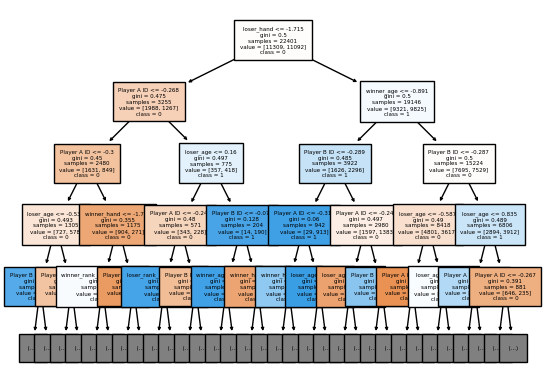

In [105]:
# Visualize the Decision Tree
#fig = plt.figure(figsize=(14,8))
tree.plot_tree(DTC,max_depth=4, 
              feature_names=['surface','tourney_level','winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','best_of','round','minutes','w_ace','w_df','w_svpt','w_1stIn','w_1stWon','w_2ndWon','w_SvGms','w_bpSaved','w_bpFaced','l_ace','l_df','l_svpt','l_1stIn','l_1stWon','l_2ndWon','l_SvGms','l_bpSaved','l_bpFaced','winner_rank_points','loser_rank_points','log tourney_date','Player A ID','Player B ID','n_sets'],
              filled=True,
              class_names=['0','1'],
              fontsize=4)
plt.show()

In [106]:
# look at the feature importances
feature_names=['surface','tourney_level','winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','best_of','round','minutes','w_ace','w_df','w_svpt','w_1stIn','w_1stWon','w_2ndWon','w_SvGms','w_bpSaved','w_bpFaced','l_ace','l_df','l_svpt','l_1stIn','l_1stWon','l_2ndWon','l_SvGms','l_bpSaved','l_bpFaced','winner_rank_points','loser_rank_points','log tourney_date','Player A ID','Player B ID','n_sets']
#dfFeatures = pd.DataFrame({'Features':feature_names.tolist(),'Importances':DTC.feature_importances_})
dfFeatures = pd.DataFrame({'Features':feature_names,'Importances':DTC.feature_importances_})
dfFeatures.sort_values(by='Importances',ascending=False).head(35)

,Features,Importances
32,Player A ID,0.268214
7,loser_age,0.220575
33,Player B ID,0.182123
4,winner_age,0.153883
31,log tourney_date,0.036373
29,winner_rank_points,0.019110
3,winner_ht,0.015525
6,loser_ht,0.015153
30,loser_rank_points,0.012218
5,loser_hand,0.007798


In [107]:
# SVM model with regularization parameter C=1 (default):
svd=SVC().fit(X_train,y_train)

print('Training accuracy: ',svd.score(X_train,y_train))
print('Testing accuracy: ',svd.score(X_test,y_test))

Training accuracy:  0.7335833221731173
Testing accuracy:  0.6714878800053569


In [108]:
# Summarize results for full dataset
df_results_full=pd.DataFrame({'Model': ['Baseline','Logistic Regression','KNN','Decision Tree', 'SVC'], 
             'Best Test Score': [0.6554171688763895,0.5685014061872238, 0.6074728806749699, 0.9241998125083701,0.6669345118521495]}).set_index('Model')
df_results_full.head()

,Best Test Score
Model,
Baseline,0.655417
Logistic Regression,0.568501
KNN,0.607473
Decision Tree,0.924200
SVC,0.666935


In [109]:
# Prepare for predictions that only use features that are known BEFORE the match
# Remove all features that are not know until after the match has been played:

In [110]:
d13_basic=d13.drop(['minutes','w_ace','w_df','w_svpt','w_1stIn','w_1stWon','w_2ndWon','w_SvGms','w_bpSaved','w_bpFaced','l_ace','l_df','l_svpt','l_1stIn','l_1stWon','l_2ndWon','l_SvGms','l_bpSaved','l_bpFaced','n_sets'],axis=1)


In [111]:
d13_basic.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,winner
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,4410.0,598.0,5.000447,104053,103429,1
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,400.0,590.0,5.000447,104958,104999,1
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,850.0,568.0,5.000447,103813,104755,0
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,151.0,1260.0,5.000447,103781,105051,0
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,1655.0,179.0,5.000447,105194,104607,0


In [419]:
d13_basic.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29868 entries, 151652 to 187940
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   surface               29868 non-null  int64  
 1   tourney_level         29868 non-null  int64  
 2   winner_hand           29868 non-null  int64  
 3   winner_ht             29868 non-null  float64
 4   winner_age            29868 non-null  float64
 5   loser_hand            29868 non-null  int64  
 6   loser_ht              29868 non-null  float64
 7   loser_age             29868 non-null  float64
 8   best_of               29868 non-null  int64  
 9   round                 29868 non-null  int64  
 10  winner_rank_points    29868 non-null  float64
 11  loser_rank_points     29868 non-null  float64
 12  log tourney_date      29868 non-null  float64
 13  Player A ID           29868 non-null  int64  
 14  Player B ID           29868 non-null  int64  
 15  winner            

In [112]:
d13_basic.shape

(29868, 16)

In [113]:
# Assign appropriate ranking points, hands, heights, and ages to Players A and B depending on who is the winner and loser, respectively

d13_basic['Player_A_rank_points']=np.where(d13_basic['winner']==1,d13_basic['winner_rank_points'],d13_basic['loser_rank_points'])
d13_basic['Player_B_rank_points']=np.where(d13_basic['winner']==0,d13_basic['winner_rank_points'],d13_basic['loser_rank_points'])

d13_basic['Player_A_hand']=np.where(d13_basic['winner']==1,d13_basic['winner_hand'],d13_basic['loser_hand'])
d13_basic['Player_B_hand']=np.where(d13_basic['winner']==0,d13_basic['winner_hand'],d13_basic['loser_hand'])

d13_basic['Player_A_ht']=np.where(d13_basic['winner']==1,d13_basic['winner_ht'],d13_basic['loser_ht'])
d13_basic['Player_B_ht']=np.where(d13_basic['winner']==0,d13_basic['winner_ht'],d13_basic['loser_ht'])

d13_basic['Player_A_age']=np.where(d13_basic['winner']==1,d13_basic['winner_age'],d13_basic['loser_age'])
d13_basic['Player_B_age']=np.where(d13_basic['winner']==0,d13_basic['winner_age'],d13_basic['loser_age'])

In [114]:
d13_basic.info()

<class 'pandas.core.frame.DataFrame'>
Index: 29868 entries, 151652 to 187940
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   surface               29868 non-null  int64  
 1   tourney_level         29868 non-null  int64  
 2   winner_hand           29868 non-null  int64  
 3   winner_ht             29868 non-null  float64
 4   winner_age            29868 non-null  float64
 5   loser_hand            29868 non-null  int64  
 6   loser_ht              29868 non-null  float64
 7   loser_age             29868 non-null  float64
 8   best_of               29868 non-null  int64  
 9   round                 29868 non-null  int64  
 10  winner_rank_points    29868 non-null  float64
 11  loser_rank_points     29868 non-null  float64
 12  log tourney_date      29868 non-null  float64
 13  Player A ID           29868 non-null  int64  
 14  Player B ID           29868 non-null  int64  
 15  winner            

In [115]:
y=d13_basic['winner']

In [116]:
X_unscaled_basic_corr=d13_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points'],axis=1)

In [117]:
# Create dataframe for correlation matrix representing feature data that is know BEFORE the match is played
X_unscaled_basic_corr.head()

,surface,tourney_level,best_of,round,log tourney_date,Player A ID,Player B ID,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151652,0,1,3,2,5.000447,104053,103429,1,4410.0,598.0,1,1,188.0,183.0,27.3,30.3
151653,0,1,3,2,5.000447,104958,104999,1,400.0,590.0,-1,-1,198.0,190.0,22.5,22.3
151654,0,1,3,2,5.000447,103813,104755,0,568.0,850.0,-1,1,185.0,185.0,28.4,23.5
151655,0,1,3,2,5.000447,103781,105051,0,1260.0,151.0,-1,1,183.0,188.0,28.6,22.1
151656,0,1,3,2,5.000447,105194,104607,0,179.0,1655.0,1,1,183.0,196.0,21.4,24.2


In [118]:
# Create correlation matrix for basic features and target feature
# Conclusion is that the features that have by far the highest correlations are the rank points of Player A and Player B - not a surprise!
# After that comes player heights, but the correlation is rather weak
corr_matrix_basic=X_unscaled_basic_corr.corr()
print(corr_matrix_basic)

                       surface  tourney_level   best_of     round  \
surface               1.000000       0.098741  0.143594 -0.078418   
tourney_level         0.098741       1.000000  0.864687 -0.531899   
best_of               0.143594       0.864687  1.000000 -0.442063   
round                -0.078418      -0.531899 -0.442063  1.000000   
log tourney_date      0.009155       0.001709  0.007160  0.011742   
Player A ID           0.025904      -0.012391 -0.008264  0.012699   
Player B ID          -0.002187      -0.028392 -0.023368  0.020377   
winner               -0.003085      -0.001609  0.001436 -0.008747   
Player_A_rank_points  0.019063       0.165266  0.090167  0.227443   
Player_B_rank_points  0.012959       0.170074  0.087056  0.231663   
Player_A_hand         0.020114       0.020750  0.015636  0.027445   
Player_B_hand         0.047735      -0.003389 -0.003091 -0.013258   
Player_A_ht           0.068953       0.028156  0.011237  0.054406   
Player_B_ht           0.061345    

In [119]:
##X_unscaled_basic=d13_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points','winner','121idx'],axis=1)
X_unscaled_basic=d13_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points','winner'],axis=1)

In [120]:
X_unscaled_basic.head()

,surface,tourney_level,best_of,round,log tourney_date,Player A ID,Player B ID,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151652,0,1,3,2,5.000447,104053,103429,4410.0,598.0,1,1,188.0,183.0,27.3,30.3
151653,0,1,3,2,5.000447,104958,104999,400.0,590.0,-1,-1,198.0,190.0,22.5,22.3
151654,0,1,3,2,5.000447,103813,104755,568.0,850.0,-1,1,185.0,185.0,28.4,23.5
151655,0,1,3,2,5.000447,103781,105051,1260.0,151.0,-1,1,183.0,188.0,28.6,22.1
151656,0,1,3,2,5.000447,105194,104607,179.0,1655.0,1,1,183.0,196.0,21.4,24.2


In [121]:
# Standardize input data
scaler_basic=StandardScaler()
X2=scaler_basic.fit_transform(X_unscaled_basic)

In [122]:
print(X2)

[[ 0.32896497 -0.75552716 -0.49200368 ... -0.57257011  0.04776612
   0.65237686]
 [ 0.32896497 -0.75552716 -0.49200368 ...  0.43173087 -1.12605224
  -1.30463824]
 [ 0.32896497 -0.75552716 -0.49200368 ... -0.28562697  0.31676616
  -1.01108597]
 ...
 [ 0.32896497 -2.01311105 -0.49200368 ...  0.14478773 -0.8081431
   1.89997398]
 [ 0.32896497 -2.01311105 -0.49200368 ... -0.57257011 -0.51468851
  -0.93769791]
 [ 0.32896497 -2.01311105 -0.49200368 ...  0.86214558  2.02858459
  -0.64414564]]


In [123]:
# Train, test, split
X2_train, X2_test, y_train, y_test=train_test_split(X2,y)
X2_train.shape

(22401, 15)

In [124]:
# Logistic Regression for basic X2 feature (only features known before match) set with penalty strength parameter 
# C=1 (default)
lr2=LogisticRegression().fit(X2_train,y_train)

print('Training accuracy: ',lr2.score(X2_train,y_train))
print('Testing accuracy: ',lr2.score(X2_test,y_test))

Training accuracy:  0.6551493236909066
Testing accuracy:  0.6519351814651132


In [125]:
# Try to improve Logistic Regression results with GridSearchCV - The below code is commented out in Phase 2 due to long processing time: 
# Conclusion: C=1 gives best result

#params = {'lr2__C': [0.01,0.1, 1, 10, 100]}
##params={'C':[0.01,0.1,1,10,100]}

##grid_lr2=GridSearchCV(lr2,param_grid=params)
##grid_lr2.fit(X2_train,y_train)
##print(grid_lr2.best_params_)

In [126]:
# KNN model with K=5 (default value):
KNN2=KNeighborsClassifier().fit(X2_train,y_train)

print('Training accuracy: ',KNN2.score(X2_train,y_train))
print('Testing accuracy: ',KNN2.score(X2_test,y_test))

Training accuracy:  0.7445649747779117
Testing accuracy:  0.5781438328646042


In [127]:
# Try to improve KNN results with GridSearchCV - the below code is commented out in Phase 2 due to long processing time
# Conclusion: K=13 gives best result (but not significantly better than K=5)

##params={'n_neighbors':range(1,21,2)}

##grid_KNN2=GridSearchCV(KNN2,param_grid=params)
##grid_KNN2.fit(X2_train,y_train)
##print(grid_KNN2.best_params_)

In [128]:
# Run KNN with n_neighbors=13

KNN2=KNeighborsClassifier(n_neighbors=13).fit(X2_train,y_train)

print('Training accuracy: ',KNN2.score(X2_train,y_train))
print('Testing accuracy: ',KNN2.score(X2_test,y_test))

Training accuracy:  0.6844783715012722
Testing accuracy:  0.6006428284451587


In [129]:
# Decision Tree model with max_depth=None (default):
DTC2=DecisionTreeClassifier().fit(X2_train,y_train)

print('Training accuracy: ',DTC2.score(X2_train,y_train))
print('Testing accuracy: ',DTC2.score(X2_test,y_test))

Training accuracy:  1.0
Testing accuracy:  0.5805544395339494


In [130]:
# Try to improve DTC with GridSearchCV - this code is commented out in Phase 2 due to long processing time:

##params={'criterion':['gini','entropy'],'max_depth':range(1,10),'min_samples_split':range(2,10),'min_samples_leaf':range(1,5)}

##grid_DTC2=GridSearchCV(DTC2,param_grid=params)
##grid_DTC2.fit(X2_train,y_train)
##print(grid_DTC2.best_params_)

In [131]:
# Run Decision Tree model with {'criterion': 'entropy', 'max_depth': 6, 'min_samples_leaf': 4, 'min_samples_split': 2}:
# Conclusion: The below hyperparameter selection does improve performance significantly, but it's still not better than baseline performance 

DTC2=DecisionTreeClassifier(criterion='entropy',max_depth=6,min_samples_leaf=4,min_samples_split=2).fit(X2_train,y_train)

print('Training accuracy: ',DTC2.score(X2_train,y_train))
print('Testing accuracy: ',DTC2.score(X2_test,y_test))

Training accuracy:  0.6628275523414133
Testing accuracy:  0.6504620329449579


In [132]:
# SVM model with regularization parameter C=1 (default):
svd2=SVC().fit(X2_train,y_train)

print('Training accuracy: ',svd2.score(X2_train,y_train))
print('Testing accuracy: ',svd2.score(X2_test,y_test))

Training accuracy:  0.6825588143386456
Testing accuracy:  0.6464443551627159


In [133]:
# Try to improve SVM model with GridSearchCV: ## Below search is very time-consuming so is commented out in Phase 2 ##

##params= {'C':[0.1, 1, 10],'gamma':[1, 0.1, 0.01],'kernel':['rbf']}  

##grid_svd2=GridSearchCV(svd2,param_grid=params)
##grid_svd2.fit(X2_train,y_train)
##print(grid_svd2.best_params_)

In [134]:
# Run SVM model with {'C': 10, 'gamma': 0.01, 'kernel': 'rbf'} ## Below run is very time-consuming so is commented out ##
# Conclusion: the hyperparameter selection based on GridSearchCV doesn't significantly change the performance, which is essentially
# on par with the baseline performance

svd2=SVC(C=10,gamma=0.01,kernel='rbf').fit(X2_train,y_train)

print('Training accuracy: ',svd2.score(X2_train,y_train))
print('Testing accuracy: ',svd2.score(X2_test,y_test))

Training accuracy:  0.6660416945672069
Testing accuracy:  0.6499263425739922


In [135]:
# Conclusion: none of the above models can do a better job than the baseline performance accuracy of 0.655

In [136]:
# Summarize results for basic dataset
df_results_basic=pd.DataFrame({'Model': ['Baseline','Logistic Regression','KNN','Decision Tree', 'SVC'], 
             'Best Test Score': [0.6554171688763895,0.6618454533279764,0.6006428284451587,0.660372304807821,0.6609079951787866]}).set_index('Model')
df_results_basic.head()

,Best Test Score
Model,
Baseline,0.655417
Logistic Regression,0.661845
KNN,0.600643
Decision Tree,0.660372
SVC,0.660908


In [137]:
# Train model on all matches played by certain player, such as Novak Djokovic with player ID = 104925

In [138]:
# Create basic dataset with all matches that Djokovic has played since 2010 using only features known BEFORE the match
nd_basic=X_unscaled_basic_corr[(X_unscaled_basic_corr['Player A ID']==104925)|(X_unscaled_basic_corr['Player B ID']==104925)]

In [228]:
nd_basic.head()

,surface,tourney_level,best_of,round,log tourney_date,Player A ID,Player B ID,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151815,0,3,5,0,5.000512,104593,104925,0,613.0,8310.0,1,1,185.0,188.0,24.4,22.6
151871,0,3,5,1,5.000512,103843,104925,0,775.0,8310.0,1,1,185.0,188.0,28.3,22.6
151899,0,3,5,2,5.000512,104797,104925,0,515.0,8310.0,1,1,188.0,188.0,23.3,22.6
151913,0,3,5,3,5.000512,103997,104925,0,573.0,8310.0,1,1,190.0,188.0,27.6,22.6
151920,0,3,5,4,5.000512,104542,104925,1,2875.0,8310.0,1,1,188.0,188.0,24.7,22.6


In [238]:
nd_basic.shape

(747, 16)

In [218]:
y_nd_basic=nd_basic['winner']

In [219]:
X_unscaled_basic_nd=nd_basic.drop('winner',axis=1)

In [222]:
X_unscaled_basic_nd.head()

,surface,tourney_level,best_of,round,log tourney_date,Player A ID,Player B ID,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151815,0,3,5,0,5.000512,104593,104925,613.0,8310.0,1,1,185.0,188.0,24.4,22.6
151871,0,3,5,1,5.000512,103843,104925,775.0,8310.0,1,1,185.0,188.0,28.3,22.6
151899,0,3,5,2,5.000512,104797,104925,515.0,8310.0,1,1,188.0,188.0,23.3,22.6
151913,0,3,5,3,5.000512,103997,104925,573.0,8310.0,1,1,190.0,188.0,27.6,22.6
151920,0,3,5,4,5.000512,104542,104925,2875.0,8310.0,1,1,188.0,188.0,24.7,22.6


In [223]:
# Standardize input data
scaler_basic_nd=StandardScaler()
X3=scaler_basic_nd.fit_transform(X_unscaled_basic_nd)

In [224]:
print(X3)

[[ 0.27914526  1.11286994  1.33690442 ...  0.14813546 -0.80174709
  -1.55594292]
 [ 0.27914526  1.11286994  1.33690442 ...  0.14813546  0.29334869
  -1.55594292]
 [ 0.27914526  1.11286994  1.33690442 ...  0.14813546 -1.11062026
  -1.55594292]
 ...
 [ 0.27914526 -0.1700218  -0.74799663 ...  0.14813546 -0.5209533
   1.77738381]
 [ 0.27914526 -2.73580527 -0.74799663 ...  0.14813546 -0.97022336
   1.77738381]
 [ 0.27914526 -2.73580527 -0.74799663 ...  1.62356467  2.28698461
  -0.93094416]]


In [230]:
# Train, test, split
X3_train_nd, X3_test_nd, y_train_nd, y_test_nd=train_test_split(X3,y_nd_basic)
X3_train_nd.shape

(560, 15)

In [229]:
# Calculate baseline performance with prediction based only on the rank points of the two players (one of them being Novak Djokovic):
error=0
for i in range(0,nd_basic.shape[0]):
    winner_rank_points=np.where(nd_basic['winner'].iloc[i]==1,nd_basic['Player_A_rank_points'].iloc[i],nd_basic['Player_B_rank_points'].iloc[i])
    loser_rank_points=np.where(nd_basic['winner'].iloc[i]==1,nd_basic['Player_B_rank_points'].iloc[i],nd_basic['Player_A_rank_points'].iloc[i])
    if (winner_rank_points<loser_rank_points): # Winner has lower rank points than loser
        error=error+1
print('Baseline performance accuracy is: ',1-error/nd.shape[0])

Baseline performance accuracy is:  0.8433734939759037


In [231]:
# Logistic Regression with penalty strength parameter C=1 (default)
lr_nd_basic=LogisticRegression().fit(X3_train_nd,y_train_nd)

print('Training accuracy: ',lr_nd_basic.score(X3_train_nd,y_train_nd))
print('Testing accuracy: ',lr_nd_basic.score(X3_test_nd,y_test_nd))

Training accuracy:  0.8482142857142857
Testing accuracy:  0.8449197860962567


In [232]:
# KNN model with K=5 (default value):
KNN_nd_basic=KNeighborsClassifier().fit(X3_train_nd,y_train_nd)

print('Training accuracy: ',KNN_nd_basic.score(X3_train_nd,y_train_nd))
print('Testing accuracy: ',KNN_nd_basic.score(X3_test_nd,y_test_nd))

Training accuracy:  0.8732142857142857
Testing accuracy:  0.8556149732620321


In [233]:
# Decision Tree model with max_depth=None (default):
DTC_nd_basic=DecisionTreeClassifier().fit(X3_train_nd,y_train_nd)

print('Training accuracy: ',DTC_nd_basic.score(X3_train_nd,y_train_nd))
print('Testing accuracy: ',DTC_nd_basic.score(X3_test_nd,y_test_nd))

Training accuracy:  1.0
Testing accuracy:  0.8021390374331551


In [235]:
# SVM model with regularization parameter C=1 (default):
svd_nd_basic=SVC().fit(X3_train_nd,y_train_nd)

print('Training accuracy: ',svd_nd_basic.score(X3_train_nd,y_train_nd))
print('Testing accuracy: ',svd_nd_basic.score(X3_test_nd,y_test_nd))

Training accuracy:  0.8732142857142857
Testing accuracy:  0.8716577540106952


In [ ]:
# Try Random Forest model

In [360]:
from sklearn.ensemble import RandomForestClassifier
rf_nd_basic=RandomForestClassifier(oob_score=True).fit(X3_train_nd,y_train_nd)

print('Training accuracy: ',rf_nd_basic.score(X3_train_nd,y_train_nd))
print('Testing accuracy: ',rf_nd_basic.score(X3_test_nd,y_test_nd))


Training accuracy:  1.0
Testing accuracy:  0.8877005347593583


In [ ]:
# Try Neural Network models with 1, 2, and 3 hidden layers and nodes from 20 to 1000

In [373]:
from tensorflow import keras
from tensorflow.keras import layers

In [376]:
# Evaluate neural network with one hidden layer and 20 nodes
# Result: max validation accuracy is 0.87
tf_nd_basic=keras.Sequential([layers.Dense(20,activation='relu'),layers.Dense(1,activation='sigmoid')])

In [377]:
tf_nd_basic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])

In [380]:
history_nd_basic=tf_nd_basic.fit(X3_train_nd,y_train_nd,validation_data=(X3_test_nd,y_test_nd),epochs=30)

Epoch 1/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8890 - loss: 0.2886 - val_accuracy: 0.8717 - val_loss: 0.3199
Epoch 2/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8901 - loss: 0.2937 - val_accuracy: 0.8663 - val_loss: 0.3202
Epoch 3/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9084 - loss: 0.2597 - val_accuracy: 0.8663 - val_loss: 0.3210
Epoch 4/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8793 - loss: 0.3244 - val_accuracy: 0.8663 - val_loss: 0.3209
Epoch 5/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8907 - loss: 0.3071 - val_accuracy: 0.8663 - val_loss: 0.3206
Epoch 6/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9030 - loss: 0.2806 - val_accuracy: 0.8663 - val_loss: 0.3211
Epoch 7/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9164 - loss: 0.2546 - val_accuracy: 0.8663 - val_loss: 0.3204
Epoch 8/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9067 - loss: 0.2669 - val_accuracy: 0.8663 - val_loss:

In [383]:
# Evaluate neural network with one hidden layer and 50 nodes
# Result: max validation accuracy is 0.88
tf_nd_basic=keras.Sequential([layers.Dense(50,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_basic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_basic=tf_nd_basic.fit(X3_train_nd,y_train_nd,validation_data=(X3_test_nd,y_test_nd),epochs=30)

Epoch 1/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.6475 - loss: 0.6363 - val_accuracy: 0.8449 - val_loss: 0.5447
Epoch 2/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7983 - loss: 0.5408 - val_accuracy: 0.8663 - val_loss: 0.4802
Epoch 3/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8332 - loss: 0.4773 - val_accuracy: 0.8663 - val_loss: 0.4376
Epoch 4/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8443 - loss: 0.4460 - val_accuracy: 0.8610 - val_loss: 0.4048
Epoch 5/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8212 - loss: 0.4516 - val_accuracy: 0.8770 - val_loss: 0.3803
Epoch 6/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8299 - loss: 0.4099 - val_accuracy: 0.8717 - val_loss: 0.3622
Epoch 7/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8502 - loss: 0.3742 - val_accuracy: 0.8663 - val_loss: 0.3523
Epoch 8/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8564 - loss: 0.3601 - val_accuracy: 0.8663 - val_loss

In [384]:
# Evaluate neural network with one hidden layer and 100 nodes
# Result: max validation accuracy is 0.87
tf_nd_basic=keras.Sequential([layers.Dense(100,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_basic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_basic=tf_nd_basic.fit(X3_train_nd,y_train_nd,validation_data=(X3_test_nd,y_test_nd),epochs=30)

Epoch 1/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.3958 - loss: 0.7625 - val_accuracy: 0.7380 - val_loss: 0.6178
Epoch 2/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7871 - loss: 0.5893 - val_accuracy: 0.8770 - val_loss: 0.5136
Epoch 3/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8520 - loss: 0.4984 - val_accuracy: 0.8824 - val_loss: 0.4478
Epoch 4/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8496 - loss: 0.4488 - val_accuracy: 0.8824 - val_loss: 0.4052
Epoch 5/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8472 - loss: 0.4169 - val_accuracy: 0.8824 - val_loss: 0.3791
Epoch 6/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8491 - loss: 0.3953 - val_accuracy: 0.8717 - val_loss: 0.3625
Epoch 7/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8585 - loss: 0.3799 - val_accuracy: 0.8556 - val_loss: 0.3516
Epoch 8/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8659 - loss: 0.3719 - val_accuracy: 0.8503 - val_loss

In [386]:
# Evaluate neural network with two hidden layers of 20 nodes each
# Result: max validation accuracy is 0.87
tf_nd_basic=keras.Sequential([layers.Dense(20,activation='relu'),layers.Dense(20,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_basic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_basic=tf_nd_basic.fit(X3_train_nd,y_train_nd,validation_data=(X3_test_nd,y_test_nd),epochs=50)

Epoch 1/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - accuracy: 0.4425 - loss: 0.7357 - val_accuracy: 0.7005 - val_loss: 0.6380
Epoch 2/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6384 - loss: 0.6401 - val_accuracy: 0.7754 - val_loss: 0.5713
Epoch 3/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6940 - loss: 0.5920 - val_accuracy: 0.7914 - val_loss: 0.5260
Epoch 4/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6883 - loss: 0.5615 - val_accuracy: 0.8128 - val_loss: 0.4864
Epoch 5/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7430 - loss: 0.5259 - val_accuracy: 0.8503 - val_loss: 0.4530
Epoch 6/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8059 - loss: 0.4838 - val_accuracy: 0.8717 - val_loss: 0.4223
Epoch 7/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8282 - loss: 0.4522 - val_accuracy: 0.8770 - val_loss: 0.3957
Epoch 8/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8553 - loss: 0.4159 - val_accuracy: 0.8877 - val_loss

In [389]:
# Evaluate neural network with two hidden layers of 50 nodes each
# Result: max validation accuracy is 0.87
tf_nd_basic=keras.Sequential([layers.Dense(50,activation='relu'),layers.Dense(50,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_basic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_basic=tf_nd_basic.fit(X3_train_nd,y_train_nd,validation_data=(X3_test_nd,y_test_nd),epochs=30)

Epoch 1/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.4759 - loss: 0.7480 - val_accuracy: 0.8235 - val_loss: 0.5768
Epoch 2/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8000 - loss: 0.5564 - val_accuracy: 0.8449 - val_loss: 0.4626
Epoch 3/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8328 - loss: 0.4629 - val_accuracy: 0.8556 - val_loss: 0.3965
Epoch 4/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8305 - loss: 0.4255 - val_accuracy: 0.8717 - val_loss: 0.3569
Epoch 5/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8225 - loss: 0.4173 - val_accuracy: 0.8770 - val_loss: 0.3399
Epoch 6/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8657 - loss: 0.3472 - val_accuracy: 0.8556 - val_loss: 0.3283
Epoch 7/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8367 - loss: 0.3706 - val_accuracy: 0.8610 - val_loss: 0.3213
Epoch 8/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8716 - loss: 0.3395 - val_accuracy: 0.8663 - val_loss

In [390]:
# Evaluate neural network with two hidden layers of 100 nodes each
# Result: max validation accuracy is 0.87
tf_nd_basic=keras.Sequential([layers.Dense(100,activation='relu'),layers.Dense(190,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_basic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_basic=tf_nd_basic.fit(X3_train_nd,y_train_nd,validation_data=(X3_test_nd,y_test_nd),epochs=30)

Epoch 1/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - accuracy: 0.6940 - loss: 0.5905 - val_accuracy: 0.8930 - val_loss: 0.3766
Epoch 2/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8381 - loss: 0.4011 - val_accuracy: 0.8824 - val_loss: 0.3384
Epoch 3/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8456 - loss: 0.3991 - val_accuracy: 0.8770 - val_loss: 0.3292
Epoch 4/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8813 - loss: 0.3386 - val_accuracy: 0.8663 - val_loss: 0.3297
Epoch 5/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8537 - loss: 0.3676 - val_accuracy: 0.8663 - val_loss: 0.3182
Epoch 6/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8888 - loss: 0.3158 - val_accuracy: 0.8930 - val_loss: 0.3203
Epoch 7/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8745 - loss: 0.3256 - val_accuracy: 0.8930 - val_loss: 0.3171
Epoch 8/30
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8668 - loss: 0.3424 - val_accuracy: 0.8877 - val_loss

In [391]:
# Evaluate neural network with three hidden layers of 20 nodes each
# Result: max validation accuracy is 0.87
tf_nd_basic=keras.Sequential([layers.Dense(20,activation='relu'),layers.Dense(20,activation='relu'),layers.Dense(20,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_basic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_basic=tf_nd_basic.fit(X3_train_nd,y_train_nd,validation_data=(X3_test_nd,y_test_nd),epochs=50)

Epoch 1/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - accuracy: 0.3599 - loss: 0.7586 - val_accuracy: 0.5455 - val_loss: 0.6841
Epoch 2/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7161 - loss: 0.6479 - val_accuracy: 0.7861 - val_loss: 0.5980
Epoch 3/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8075 - loss: 0.5843 - val_accuracy: 0.8021 - val_loss: 0.5237
Epoch 4/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8193 - loss: 0.5296 - val_accuracy: 0.8128 - val_loss: 0.4623
Epoch 5/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8227 - loss: 0.4783 - val_accuracy: 0.8342 - val_loss: 0.4154
Epoch 6/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8314 - loss: 0.4439 - val_accuracy: 0.8289 - val_loss: 0.3853
Epoch 7/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8514 - loss: 0.4003 - val_accuracy: 0.8289 - val_loss: 0.3650
Epoch 8/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8332 - loss: 0.3947 - val_accuracy: 0.8449 - val_loss

In [415]:
# Evaluate neural network with three hidden layers of 50 nodes each
# Result: max validation accuracy is 0.86
tf_nd_basic=keras.Sequential([layers.Dense(50,activation='relu'),layers.Dense(50,activation='relu'),layers.Dense(50,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_basic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_basic=tf_nd_basic.fit(X3_train_nd,y_train_nd,validation_data=(X3_test_nd,y_test_nd),epochs=50)

Epoch 1/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - accuracy: 0.7101 - loss: 0.6277 - val_accuracy: 0.8556 - val_loss: 0.4859
Epoch 2/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8261 - loss: 0.4872 - val_accuracy: 0.8503 - val_loss: 0.3981
Epoch 3/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8418 - loss: 0.4089 - val_accuracy: 0.8556 - val_loss: 0.3680
Epoch 4/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8755 - loss: 0.3290 - val_accuracy: 0.8556 - val_loss: 0.3664
Epoch 5/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8690 - loss: 0.3489 - val_accuracy: 0.8556 - val_loss: 0.3588
Epoch 6/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8852 - loss: 0.3288 - val_accuracy: 0.8503 - val_loss: 0.3564
Epoch 7/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8541 - loss: 0.3529 - val_accuracy: 0.8503 - val_loss: 0.3503
Epoch 8/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8560 - loss: 0.3510 - val_accuracy: 0.8449 - val_loss

In [ ]:
# Conclusion: The SVM model with 0.87 accuracy and Random Forest model with 0.89 accuracy clearly perform better than the baseline performance (0.84)
# for the basic data set containing only features that are know before the match
# A relatively simple neural network with one hidden layer and 50 nodes performed at 0.88 accuracy. Additional layers and nodes did not improve accuracy
# Also, by training a model around a single player, prediction performnance can be improved from 0.66 to 0.87-0.89 accuracy 

In [416]:
# Summarize results for dataset with Djokovic matches using only features known before the match
df_results_basic_djoko=pd.DataFrame({'Model': ['Baseline','Logistic Regression','KNN','Decision Tree','SVC','Random Forest','Neural Network'], 
             'Test Score': [0.8433734939759037,0.8449197860962567,0.8556149732620321,0.8021390374331551,0.8716577540106952,0.8877005347593583,0.88]}).set_index('Model')
df_results_basic_djoko.head(7)

,Test Score
Model,
Baseline,0.843373
Logistic Regression,0.844920
KNN,0.855615
Decision Tree,0.802139
SVC,0.871658
Random Forest,0.887701
Neural Network,0.880000


In [ ]:
# Develop an enhanced model that is trained around a certain player such as Djokovic and where opponent names are encoded using 
# binary dummy variables in an attempt to improve prediction performance for the basic feature set (containing only info known ahead of the match)

In [239]:
d11e=d10.drop(['tourney_id','tourney_name','draw_size','tourney_date','match_num','winner_id','winner_seed','winner_entry','winner_name','winner_ioc','loser_id','loser_seed','loser_entry','loser_name','loser_ioc','score','winner_rank','loser_rank','w_sets','l_sets'],axis=1)


In [242]:
d11e.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_bpFaced,winner_rank_points,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,n_sets
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,...,5.0,4410.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A,2
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,...,10.0,400.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A,2
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,...,11.0,850.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B,3
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,...,5.0,151.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B,2
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,...,9.0,1655.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B,2


In [243]:
d11e.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31652 entries, 151652 to 187940
Data columns (total 38 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   surface             31652 non-null  int64  
 1   tourney_level       31652 non-null  int64  
 2   winner_hand         31652 non-null  int64  
 3   winner_ht           31607 non-null  float64
 4   winner_age          31652 non-null  float64
 5   loser_hand          31652 non-null  int64  
 6   loser_ht            31457 non-null  float64
 7   loser_age           31651 non-null  float64
 8   best_of             31652 non-null  int64  
 9   round               31652 non-null  int64  
 10  minutes             30168 non-null  float64
 11  w_ace               31521 non-null  float64
 12  w_df                31521 non-null  float64
 13  w_svpt              31521 non-null  float64
 14  w_1stIn             31521 non-null  float64
 15  w_1stWon            31521 non-null  float64
 16  w_2

In [248]:
d12e_basic=d11e.drop(['minutes','w_ace','w_df','w_svpt','w_1stIn','w_1stWon','w_2ndWon','w_SvGms','w_bpSaved','w_bpFaced','l_ace','l_df','l_svpt','l_1stIn','l_1stWon','l_2ndWon','l_SvGms','l_bpSaved','l_bpFaced','n_sets'],axis=1)

In [275]:
d12e_basic.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,winner_rank_points,loser_rank_points,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,4410.0,598.0,Andy Roddick,Peter Luczak,5.000447,104053,103429,A
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,400.0,590.0,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,850.0,568.0,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,151.0,1260.0,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,1655.0,179.0,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B


In [255]:
d12e_basic.shape

(31652, 18)

In [276]:
d13e_basic=d12e_basic.dropna()

In [277]:
d13e_basic.shape

(31348, 18)

In [278]:
d14e_basic=d13e_basic.copy()

In [283]:
# Assign appropriate ranking points, hands, heights, and ages to Players A and B depending on who is the winner and loser, respectively

d14e_basic['Player_A_rank_points']=np.where(d14e_basic['winner']=='A',d14e_basic['winner_rank_points'],d14e_basic['loser_rank_points'])
d14e_basic['Player_B_rank_points']=np.where(d14e_basic['winner']=='B',d14e_basic['winner_rank_points'],d14e_basic['loser_rank_points'])

d14e_basic['Player_A_hand']=np.where(d14e_basic['winner']=='A',d14e_basic['winner_hand'],d14e_basic['loser_hand'])
d14e_basic['Player_B_hand']=np.where(d14e_basic['winner']=='B',d14e_basic['winner_hand'],d14e_basic['loser_hand'])

d14e_basic['Player_A_ht']=np.where(d14e_basic['winner']=='A',d14e_basic['winner_ht'],d14e_basic['loser_ht'])
d14e_basic['Player_B_ht']=np.where(d14e_basic['winner']=='B',d14e_basic['winner_ht'],d14e_basic['loser_ht'])

d14e_basic['Player_A_age']=np.where(d14e_basic['winner']=='A',d14e_basic['winner_age'],d14e_basic['loser_age'])
d14e_basic['Player_B_age']=np.where(d14e_basic['winner']=='B',d14e_basic['winner_age'],d14e_basic['loser_age'])

In [284]:
d14e_basic.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,Player B ID,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151652,0,1,1,188.0,27.3,1,183.0,30.3,3,2,...,103429,A,4410.0,598.0,1,1,188.0,183.0,27.3,30.3
151653,0,1,-1,198.0,22.5,-1,190.0,22.3,3,2,...,104999,A,400.0,590.0,-1,-1,198.0,190.0,22.5,22.3
151654,0,1,1,185.0,23.5,-1,185.0,28.4,3,2,...,104755,B,568.0,850.0,-1,1,185.0,185.0,28.4,23.5
151655,0,1,1,188.0,22.1,-1,183.0,28.6,3,2,...,105051,B,1260.0,151.0,-1,1,183.0,188.0,28.6,22.1
151656,0,1,1,196.0,24.2,1,183.0,21.4,3,2,...,104607,B,179.0,1655.0,1,1,183.0,196.0,21.4,24.2


In [285]:
d14e_basic.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31348 entries, 151652 to 187940
Data columns (total 26 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   surface               31348 non-null  int64  
 1   tourney_level         31348 non-null  int64  
 2   winner_hand           31348 non-null  int64  
 3   winner_ht             31348 non-null  float64
 4   winner_age            31348 non-null  float64
 5   loser_hand            31348 non-null  int64  
 6   loser_ht              31348 non-null  float64
 7   loser_age             31348 non-null  float64
 8   best_of               31348 non-null  int64  
 9   round                 31348 non-null  int64  
 10  winner_rank_points    31348 non-null  float64
 11  loser_rank_points     31348 non-null  float64
 12  Player A              31348 non-null  object 
 13  Player B              31348 non-null  object 
 14  log tourney_date      31348 non-null  float64
 15  Player A ID       

In [286]:
d15e_basic=d14e_basic.drop(['winner_hand','winner_ht','winner_age','loser_hand','loser_ht','loser_age','winner_rank_points','loser_rank_points'],axis=1)

In [287]:
d15e_basic.head()

,surface,tourney_level,best_of,round,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151652,0,1,3,2,Andy Roddick,Peter Luczak,5.000447,104053,103429,A,4410.0,598.0,1,1,188.0,183.0,27.3,30.3
151653,0,1,3,2,Carsten Ball,Mischa Zverev,5.000447,104958,104999,A,400.0,590.0,-1,-1,198.0,190.0,22.5,22.3
151654,0,1,3,2,Jarkko Nieminen,Richard Gasquet,5.000447,103813,104755,B,568.0,850.0,-1,1,185.0,185.0,28.4,23.5
151655,0,1,3,2,Jurgen Melzer,Matthew Ebden,5.000447,103781,105051,B,1260.0,151.0,-1,1,183.0,188.0,28.6,22.1
151656,0,1,3,2,Nick Lindahl,Tomas Berdych,5.000447,105194,104607,B,179.0,1655.0,1,1,183.0,196.0,21.4,24.2


In [288]:
# Create enhanced dataset with only matches played by Novak Djokovic that will be used with dummy encoding of opponents
nd_ebasic=d15e_basic[(d15e_basic['Player A']=='Novak Djokovic')|(d15e_basic['Player B']=='Novak Djokovic')]

In [293]:
nd_ebasic.head()

,surface,tourney_level,best_of,round,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age
151815,0,3,5,0,Daniel Gimeno Traver,Novak Djokovic,5.000512,104593,104925,B,613.0,8310.0,1,1,185.0,188.0,24.4,22.6
151871,0,3,5,1,Marco Chiudinelli,Novak Djokovic,5.000512,103843,104925,B,775.0,8310.0,1,1,185.0,188.0,28.3,22.6
151899,0,3,5,2,Denis Istomin,Novak Djokovic,5.000512,104797,104925,B,515.0,8310.0,1,1,188.0,188.0,23.3,22.6
151913,0,3,5,3,Lukasz Kubot,Novak Djokovic,5.000512,103997,104925,B,573.0,8310.0,1,1,190.0,188.0,27.6,22.6
151920,0,3,5,4,Jo-Wilfried Tsonga,Novak Djokovic,5.000512,104542,104925,A,2875.0,8310.0,1,1,188.0,188.0,24.7,22.6


In [294]:
nd_ebasic.shape

(797, 18)

In [296]:
nd_ebasic1=nd_ebasic.copy()

In [297]:
# Create new feature 'O' for Opponent
nd_ebasic1['O']=np.where((nd_ebasic['Player A']=='Novak Djokovic'),nd_ebasic['Player B'],nd_ebasic['Player A'])

In [298]:
nd_ebasic1.head()

,surface,tourney_level,best_of,round,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,Player_A_ht,Player_B_ht,Player_A_age,Player_B_age,O
151815,0,3,5,0,Daniel Gimeno Traver,Novak Djokovic,5.000512,104593,104925,B,613.0,8310.0,1,1,185.0,188.0,24.4,22.6,Daniel Gimeno Traver
151871,0,3,5,1,Marco Chiudinelli,Novak Djokovic,5.000512,103843,104925,B,775.0,8310.0,1,1,185.0,188.0,28.3,22.6,Marco Chiudinelli
151899,0,3,5,2,Denis Istomin,Novak Djokovic,5.000512,104797,104925,B,515.0,8310.0,1,1,188.0,188.0,23.3,22.6,Denis Istomin
151913,0,3,5,3,Lukasz Kubot,Novak Djokovic,5.000512,103997,104925,B,573.0,8310.0,1,1,190.0,188.0,27.6,22.6,Lukasz Kubot
151920,0,3,5,4,Jo-Wilfried Tsonga,Novak Djokovic,5.000512,104542,104925,A,2875.0,8310.0,1,1,188.0,188.0,24.7,22.6,Jo-Wilfried Tsonga


In [320]:
# Check number of matches against each opponent: In total Djokovic has 206 opponents in dataset
#nd_ebasic1['O'].value_counts()[0:40]
nd_ebasic1['O'].value_counts()

O
Rafael Nadal        37
Roger Federer       33
Andy Murray         27
Kei Nishikori       19
Tomas Berdych       16
                    ..
Jaume Munar          1
Nicolas Devilder     1
Taro Daniel          1
Adam Pavlasek        1
Maxime Cressy        1
Name: count, Length: 206, dtype: int64

In [307]:
# Creat binary dummy variables for oppenent names (one-hot encoding)
nd_ebasic2=pd.get_dummies(data=nd_ebasic1,columns=['O'],dtype=int)

In [313]:
nd_ebasic2.head()

,surface,tourney_level,best_of,round,Player A,Player B,log tourney_date,Player A ID,Player B ID,winner,...,O_Tommy Haas,O_Tommy Robredo,O_Ugo Humbert,O_Vasek Pospisil,O_Victor Hanescu,O_Viktor Troicki,O_Xavier Malisse,O_Yen Hsun Lu,O_Yoshihito Nishioka,O_Ze Zhang
151815,0,3,5,0,Daniel Gimeno Traver,Novak Djokovic,5.000512,104593,104925,B,...,0,0,0,0,0,0,0,0,0,0
151871,0,3,5,1,Marco Chiudinelli,Novak Djokovic,5.000512,103843,104925,B,...,0,0,0,0,0,0,0,0,0,0
151899,0,3,5,2,Denis Istomin,Novak Djokovic,5.000512,104797,104925,B,...,0,0,0,0,0,0,0,0,0,0
151913,0,3,5,3,Lukasz Kubot,Novak Djokovic,5.000512,103997,104925,B,...,0,0,0,0,0,0,0,0,0,0
151920,0,3,5,4,Jo-Wilfried Tsonga,Novak Djokovic,5.000512,104542,104925,A,...,0,0,0,0,0,0,0,0,0,0


In [314]:
nd_ebasic3=nd_ebasic2.drop(['Player A','Player B','Player A ID','Player B ID'],axis=1)

In [315]:
nd_ebasic3.head()

,surface,tourney_level,best_of,round,log tourney_date,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,...,O_Tommy Haas,O_Tommy Robredo,O_Ugo Humbert,O_Vasek Pospisil,O_Victor Hanescu,O_Viktor Troicki,O_Xavier Malisse,O_Yen Hsun Lu,O_Yoshihito Nishioka,O_Ze Zhang
151815,0,3,5,0,5.000512,B,613.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0
151871,0,3,5,1,5.000512,B,775.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0
151899,0,3,5,2,5.000512,B,515.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0
151913,0,3,5,3,5.000512,B,573.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0
151920,0,3,5,4,5.000512,A,2875.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0


In [316]:
nd_ebasic3.info()

<class 'pandas.core.frame.DataFrame'>
Index: 797 entries, 151815 to 187940
Columns: 220 entries, surface to O_Ze Zhang
dtypes: float64(7), int32(206), int64(6), object(1)
memory usage: 734.7+ KB


In [317]:
# Replace 'winner' categories with A=1, B=0
nd_ebasic4=nd_ebasic3.copy()
nd_ebasic4['winner'].replace(to_replace=['A','B'],value=[1,0],inplace=True)
# Encoding of winner is now implicit: If Player A (whose first name always comes before Player B in alphabetical order) wins, winner=1.
# If Player B wins, winner=0

In [322]:
nd_ebasic4.head()

,surface,tourney_level,best_of,round,log tourney_date,winner,Player_A_rank_points,Player_B_rank_points,Player_A_hand,Player_B_hand,...,O_Tommy Haas,O_Tommy Robredo,O_Ugo Humbert,O_Vasek Pospisil,O_Victor Hanescu,O_Viktor Troicki,O_Xavier Malisse,O_Yen Hsun Lu,O_Yoshihito Nishioka,O_Ze Zhang
151815,0,3,5,0,5.000512,0,613.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0
151871,0,3,5,1,5.000512,0,775.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0
151899,0,3,5,2,5.000512,0,515.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0
151913,0,3,5,3,5.000512,0,573.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0
151920,0,3,5,4,5.000512,1,2875.0,8310.0,1,1,...,0,0,0,0,0,0,0,0,0,0


In [321]:
# Allocate target feature
y_nd_ebasic=nd_ebasic4['winner']

In [323]:
# Create unscaled feature set 
X_unscaled_ebasic_nd=nd_ebasic4.drop('winner',axis=1)

In [324]:
# Standardize input data
scaler_ebasic_nd=StandardScaler()
Xe=scaler_ebasic_nd.fit_transform(X_unscaled_ebasic_nd)

In [326]:
# Train, test, split
Xe_train_nd, Xe_test_nd, ye_train_nd, ye_test_nd=train_test_split(Xe,y_nd_ebasic)
Xe_train_nd.shape

(597, 219)

In [327]:
# Calculate baseline performance with prediction based only on the rank points of the two players (one of them being Novak Djokovic):
error=0
for i in range(0,nd_ebasic4.shape[0]):
    winner_rank_points=np.where(nd_ebasic4['winner'].iloc[i]==1,nd_ebasic4['Player_A_rank_points'].iloc[i],nd_ebasic4['Player_B_rank_points'].iloc[i])
    loser_rank_points=np.where(nd_ebasic4['winner'].iloc[i]==1,nd_ebasic4['Player_B_rank_points'].iloc[i],nd_ebasic4['Player_A_rank_points'].iloc[i])
    if (winner_rank_points<loser_rank_points): # Winner has lower rank points than loser
        error=error+1
print('Baseline performance accuracy is: ',1-error/nd.shape[0])

Baseline performance accuracy is:  0.8393574297188755


In [328]:
# Logistic Regression with penalty strength parameter C=1 (default)
lr_nd_ebasic=LogisticRegression().fit(Xe_train_nd,ye_train_nd)

print('Training accuracy: ',lr_nd_ebasic.score(Xe_train_nd,ye_train_nd))
print('Testing accuracy: ',lr_nd_ebasic.score(Xe_test_nd,ye_test_nd))

Training accuracy:  0.8944723618090452
Testing accuracy:  0.79


In [329]:
# KNN model with K=5 (default value):
KNN_nd_ebasic=KNeighborsClassifier().fit(Xe_train_nd,ye_train_nd)

print('Training accuracy: ',KNN_nd_ebasic.score(Xe_train_nd,ye_train_nd))
print('Testing accuracy: ',KNN_nd_ebasic.score(Xe_test_nd,ye_test_nd))

Training accuracy:  0.8777219430485762
Testing accuracy:  0.765


In [330]:
# Decision Tree model with max_depth=None (default):
DTC_nd_ebasic=DecisionTreeClassifier().fit(Xe_train_nd,ye_train_nd)

print('Training accuracy: ',DTC_nd_ebasic.score(Xe_train_nd,ye_train_nd))
print('Testing accuracy: ',DTC_nd_ebasic.score(Xe_test_nd,ye_test_nd))

Training accuracy:  1.0
Testing accuracy:  0.735


In [331]:
# SVM model with regularization parameter C=1 (default):
svd_nd_ebasic=SVC().fit(Xe_train_nd,ye_train_nd)

print('Training accuracy: ',svd_nd_ebasic.score(Xe_train_nd,ye_train_nd))
print('Testing accuracy: ',svd_nd_ebasic.score(Xe_test_nd,ye_test_nd))

Training accuracy:  0.897822445561139
Testing accuracy:  0.79


In [371]:
# Random Forest model with default options
rf_nd_ebasic=RandomForestClassifier(oob_score=True).fit(Xe_train_nd,ye_train_nd)

print('Training accuracy: ',rf_nd_ebasic.score(Xe_train_nd,ye_train_nd))
print('Testing accuracy: ',rf_nd_ebasic.score(Xe_test_nd,ye_test_nd))

Training accuracy:  1.0
Testing accuracy:  0.825


In [417]:
# Summarize results for dataset with Djokovic matches using only features known before the match and one-hot encoding of opponents:
# Dummy binary encoding resulted in lower overall prediction performance with none of models performing better than the baseline model
# A relatively simple neural network with one hidden layer and 100 nodes performed at 0.81 accuracy (more layers and nodes did not improve results) 
df_results_ebasic_djoko=pd.DataFrame({'Model': ['Baseline','Logistic Regression','KNN','Decision Tree', 'SVC','Random Forest','Neural Network'], 
             'Test Score': [0.8393574297188755,0.79,0.765,0.735,0.79,0.825,0.81]}).set_index('Model')
df_results_ebasic_djoko.head(7)

,Test Score
Model,
Baseline,0.839357
Logistic Regression,0.790000
KNN,0.765000
Decision Tree,0.735000
SVC,0.790000
Random Forest,0.825000
Neural Network,0.810000


In [ ]:
# Try neural network models with one, two, and three hidden layers:

In [393]:
# Evaluate neural network with one hidden layer and 20 nodes
# Result: max validation accuracy is 0.79 
tf_nd_ebasic=keras.Sequential([layers.Dense(20,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=30)


Epoch 1/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5450 - loss: 0.7275 - val_accuracy: 0.6100 - val_loss: 0.6944
Epoch 2/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6739 - loss: 0.6112 - val_accuracy: 0.6350 - val_loss: 0.6274
Epoch 3/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7858 - loss: 0.4890 - val_accuracy: 0.6800 - val_loss: 0.5797
Epoch 4/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8079 - loss: 0.4664 - val_accuracy: 0.7200 - val_loss: 0.5426
Epoch 5/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8491 - loss: 0.4040 - val_accuracy: 0.7550 - val_loss: 0.5196
Epoch 6/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8645 - loss: 0.3802 - val_accuracy: 0.7700 - val_loss: 0.5018
Epoch 7/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8836 - loss: 0.3262 - val_accuracy: 0.7800 - val_loss: 0.4921
Epoch 8/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8895 - loss: 0.3119 - val_accuracy: 0.7850 - val_loss

In [394]:
# Evaluate neural network with one hidden layer and 50 nodes
# Result: max validation accuracy is 0.80 
tf_nd_ebasic=keras.Sequential([layers.Dense(50,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=30)

Epoch 1/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.5710 - loss: 0.7946 - val_accuracy: 0.7000 - val_loss: 0.6328
Epoch 2/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7562 - loss: 0.5246 - val_accuracy: 0.7650 - val_loss: 0.5868
Epoch 3/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8135 - loss: 0.4408 - val_accuracy: 0.7850 - val_loss: 0.5517
Epoch 4/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8729 - loss: 0.3468 - val_accuracy: 0.7950 - val_loss: 0.5320
Epoch 5/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8607 - loss: 0.3298 - val_accuracy: 0.8100 - val_loss: 0.5168
Epoch 6/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8888 - loss: 0.2917 - val_accuracy: 0.8100 - val_loss: 0.5131
Epoch 7/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8847 - loss: 0.2795 - val_accuracy: 0.8100 - val_loss: 0.5080
Epoch 8/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8795 - loss: 0.2714 - val_accuracy: 0.8100 - val_loss

In [413]:
# Evaluate neural network with one hidden layer and 100 nodes
# Result: max validation accuracy is 0.81
tf_nd_ebasic=keras.Sequential([layers.Dense(100,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=30)

Epoch 1/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6518 - loss: 0.6802 - val_accuracy: 0.7200 - val_loss: 0.5078
Epoch 2/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8143 - loss: 0.4389 - val_accuracy: 0.7750 - val_loss: 0.4644
Epoch 3/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8767 - loss: 0.3358 - val_accuracy: 0.8050 - val_loss: 0.4458
Epoch 4/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8984 - loss: 0.2889 - val_accuracy: 0.8150 - val_loss: 0.4379
Epoch 5/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8979 - loss: 0.2642 - val_accuracy: 0.8250 - val_loss: 0.4444
Epoch 6/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8998 - loss: 0.2373 - val_accuracy: 0.8250 - val_loss: 0.4467
Epoch 7/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9082 - loss: 0.2334 - val_accuracy: 0.8100 - val_loss: 0.4558
Epoch 8/30
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8973 - loss: 0.2424 - val_accuracy: 0.8100 - val_loss

In [397]:
# Evaluate neural network with two hidden layers of 20 nodes each
# Result: max validation accuracy is 0.80
tf_nd_ebasic=keras.Sequential([layers.Dense(20,activation='relu'),layers.Dense(20,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=100)

Epoch 1/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.6044 - loss: 0.6742 - val_accuracy: 0.7050 - val_loss: 0.5906
Epoch 2/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7374 - loss: 0.5618 - val_accuracy: 0.7200 - val_loss: 0.5574
Epoch 3/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7766 - loss: 0.5191 - val_accuracy: 0.7650 - val_loss: 0.5333
Epoch 4/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8207 - loss: 0.4699 - val_accuracy: 0.7550 - val_loss: 0.5143
Epoch 5/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8477 - loss: 0.4072 - val_accuracy: 0.7650 - val_loss: 0.5020
Epoch 6/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8557 - loss: 0.3737 - val_accuracy: 0.7500 - val_loss: 0.4962
Epoch 7/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8586 - loss: 0.3469 - val_accuracy: 0.7550 - val_loss: 0.4897
Epoch 8/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8909 - loss: 0.3026 - val_accuracy: 0.7600 - 

In [400]:
# Evaluate neural network with two hidden layers of 50 nodes each
# Result: max validation accuracy is 0.79
tf_nd_ebasic=keras.Sequential([layers.Dense(50,activation='relu'),layers.Dense(50,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=50)

Epoch 1/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.6241 - loss: 0.6646 - val_accuracy: 0.7200 - val_loss: 0.5623
Epoch 2/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8109 - loss: 0.4919 - val_accuracy: 0.7600 - val_loss: 0.5140
Epoch 3/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8428 - loss: 0.4252 - val_accuracy: 0.7600 - val_loss: 0.4900
Epoch 4/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8528 - loss: 0.3572 - val_accuracy: 0.7800 - val_loss: 0.4722
Epoch 5/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8712 - loss: 0.3182 - val_accuracy: 0.7900 - val_loss: 0.4702
Epoch 6/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8667 - loss: 0.3100 - val_accuracy: 0.7800 - val_loss: 0.4731
Epoch 7/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9059 - loss: 0.2489 - val_accuracy: 0.7800 - val_loss: 0.4750
Epoch 8/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9000 - loss: 0.2532 - val_accuracy: 0.7750 - val_loss

In [401]:
# Evaluate neural network with two hidden layers of 100 nodes each
# Result: max validation accuracy is 0.77
tf_nd_ebasic=keras.Sequential([layers.Dense(100,activation='relu'),layers.Dense(100,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=50)

Epoch 1/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.7327 - loss: 0.5666 - val_accuracy: 0.7300 - val_loss: 0.5483
Epoch 2/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8445 - loss: 0.3925 - val_accuracy: 0.7950 - val_loss: 0.5035
Epoch 3/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8940 - loss: 0.2850 - val_accuracy: 0.7900 - val_loss: 0.5006
Epoch 4/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8950 - loss: 0.2690 - val_accuracy: 0.7850 - val_loss: 0.5003
Epoch 5/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9093 - loss: 0.2412 - val_accuracy: 0.7850 - val_loss: 0.5123
Epoch 6/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9139 - loss: 0.2068 - val_accuracy: 0.7700 - val_loss: 0.5267
Epoch 7/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9201 - loss: 0.2037 - val_accuracy: 0.7950 - val_loss: 0.5379
Epoch 8/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9236 - loss: 0.2024 - val_accuracy: 0.7750 - val_loss

In [402]:
# Evaluate neural network with three hidden layers of 20 nodes each
# Result: max validation accuracy is 0.80
tf_nd_ebasic=keras.Sequential([layers.Dense(20,activation='relu'),layers.Dense(20,activation='relu'),layers.Dense(20,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=50)

Epoch 1/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.6281 - loss: 0.6754 - val_accuracy: 0.6900 - val_loss: 0.6025
Epoch 2/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6912 - loss: 0.5949 - val_accuracy: 0.7050 - val_loss: 0.5786
Epoch 3/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7240 - loss: 0.5505 - val_accuracy: 0.7150 - val_loss: 0.5502
Epoch 4/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7163 - loss: 0.5295 - val_accuracy: 0.7350 - val_loss: 0.5261
Epoch 5/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7546 - loss: 0.5038 - val_accuracy: 0.7650 - val_loss: 0.5073
Epoch 6/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8151 - loss: 0.4775 - val_accuracy: 0.7550 - val_loss: 0.4944
Epoch 7/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8461 - loss: 0.4163 - val_accuracy: 0.7950 - val_loss: 0.4835
Epoch 8/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8700 - loss: 0.3660 - val_accuracy: 0.7950 - val_loss

In [403]:
# Evaluate neural network with three hidden layers of 50 nodes each
# Result: max validation accuracy is 0.79
tf_nd_ebasic=keras.Sequential([layers.Dense(50,activation='relu'),layers.Dense(50,activation='relu'),layers.Dense(50,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=50)

Epoch 1/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.5930 - loss: 0.6740 - val_accuracy: 0.6800 - val_loss: 0.6130
Epoch 2/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7183 - loss: 0.5696 - val_accuracy: 0.7500 - val_loss: 0.5668
Epoch 3/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8265 - loss: 0.4626 - val_accuracy: 0.7700 - val_loss: 0.5117
Epoch 4/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8631 - loss: 0.3898 - val_accuracy: 0.7850 - val_loss: 0.4961
Epoch 5/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8893 - loss: 0.3016 - val_accuracy: 0.8000 - val_loss: 0.4934
Epoch 6/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9133 - loss: 0.2606 - val_accuracy: 0.8050 - val_loss: 0.4813
Epoch 7/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9030 - loss: 0.2629 - val_accuracy: 0.7900 - val_loss: 0.5095
Epoch 8/50
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9048 - loss: 0.2384 - val_accuracy: 0.8000 - val_loss

In [409]:
# Evaluate neural network with three hidden layers of 1000 nodes each
# Result: max validation accuracy is 0.78
tf_nd_ebasic=keras.Sequential([layers.Dense(1000,activation='relu'),layers.Dense(1000,activation='relu'),layers.Dense(1000,activation='relu'),layers.Dense(1,activation='sigmoid')])
tf_nd_ebasic.compile(optimizer='rmsprop',loss='binary_crossentropy',metrics=['accuracy'])
history_nd_ebasic=tf_nd_ebasic.fit(Xe_train_nd,ye_train_nd,validation_data=(Xe_test_nd,ye_test_nd),epochs=100)

Epoch 1/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - accuracy: 0.6786 - loss: 0.8899 - val_accuracy: 0.7900 - val_loss: 0.4693
Epoch 2/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.8847 - loss: 0.2966 - val_accuracy: 0.8050 - val_loss: 0.4263
Epoch 3/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.8772 - loss: 0.2720 - val_accuracy: 0.7950 - val_loss: 0.4517
Epoch 4/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.9060 - loss: 0.2322 - val_accuracy: 0.7800 - val_loss: 0.4706
Epoch 5/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - accuracy: 0.8957 - loss: 0.2333 - val_accuracy: 0.8200 - val_loss: 0.4552
Epoch 6/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.8893 - loss: 0.2443 - val_accuracy: 0.7700 - val_loss: 0.5679
Epoch 7/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.8998 - loss: 0.2133 - val_accuracy: 0.8000 - val_loss: 0.5335
Epoch 8/100
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - accuracy: 0.8892 - loss: 0.2207 - val_accuracy: 0.

In [154]:
# Train model on all matches played by certain player, such as Novak Djokovic with player ID = 104925, using FULL dataset

In [237]:
# Create dataset with all matches that Djokovic has played since 2010 containing ALL features
nd=d13[(d13['Player A ID']==104925)|(d13['Player B ID']==104925)]

In [156]:
nd.shape

(747, 36)

In [157]:
nd.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,l_SvGms,l_bpSaved,l_bpFaced,winner_rank_points,loser_rank_points,log tourney_date,Player A ID,Player B ID,winner,n_sets
151815,0,3,1,188.0,22.6,1,185.0,24.4,5,0,...,14.0,9.0,14.0,8310.0,613.0,5.000512,104593,104925,0,3
151871,0,3,1,188.0,22.6,1,185.0,28.3,5,1,...,16.0,10.0,18.0,8310.0,775.0,5.000512,103843,104925,0,4
151899,0,3,1,188.0,22.6,1,188.0,23.3,5,2,...,11.0,5.0,14.0,8310.0,515.0,5.000512,104797,104925,0,3
151913,0,3,1,188.0,22.6,1,190.0,27.6,5,3,...,13.0,3.0,9.0,8310.0,573.0,5.000512,103997,104925,0,3
151920,0,3,1,188.0,24.7,1,188.0,22.6,5,4,...,24.0,4.0,11.0,2875.0,8310.0,5.000512,104542,104925,1,5


In [158]:
nd.info()

<class 'pandas.core.frame.DataFrame'>
Index: 747 entries, 151815 to 187940
Data columns (total 36 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   surface             747 non-null    int64  
 1   tourney_level       747 non-null    int64  
 2   winner_hand         747 non-null    int64  
 3   winner_ht           747 non-null    float64
 4   winner_age          747 non-null    float64
 5   loser_hand          747 non-null    int64  
 6   loser_ht            747 non-null    float64
 7   loser_age           747 non-null    float64
 8   best_of             747 non-null    int64  
 9   round               747 non-null    int64  
 10  minutes             747 non-null    float64
 11  w_ace               747 non-null    float64
 12  w_df                747 non-null    float64
 13  w_svpt              747 non-null    float64
 14  w_1stIn             747 non-null    float64
 15  w_1stWon            747 non-null    float64
 16  w_2nd

In [159]:
nd['winner'].value_counts()

winner
0    484
1    263
Name: count, dtype: int64

In [160]:
nd_corr=nd.corr()
print(nd_corr)

                     surface  tourney_level  winner_hand  winner_ht  \
surface             1.000000       0.033250     0.166972   0.082687   
tourney_level       0.033250       1.000000    -0.033423  -0.070075   
winner_hand         0.166972      -0.033423     1.000000   0.079482   
winner_ht           0.082687      -0.070075     0.079482   1.000000   
winner_age         -0.016577       0.017033    -0.024665  -0.097926   
loser_hand          0.008282       0.032235    -0.059722   0.007649   
loser_ht            0.073031      -0.056523    -0.018033   0.002310   
loser_age           0.006447      -0.040022    -0.010634   0.043695   
best_of             0.185705       0.832423    -0.007866  -0.054898   
round              -0.040338      -0.281377    -0.149434  -0.002045   
minutes             0.008635       0.437386    -0.154566  -0.058626   
w_ace               0.366169       0.220275     0.075283   0.251492   
w_df                0.105295       0.139393    -0.010271   0.014873   
w_svpt

In [161]:
ynd=nd['winner']

In [162]:
X_unscaled_nd=nd.drop(['winner'],axis=1)

In [163]:
# Standardize input data
scaler_nd=StandardScaler()
Xnd=scaler_nd.fit_transform(X_unscaled_nd)

In [164]:
# Train, test, split
Xnd_train, Xnd_test, ynd_train, ynd_test=train_test_split(Xnd,ynd)
Xnd_train.shape

(560, 35)

In [165]:
# Calculate baseline performance with prediction based only on the rank points of the two players (one of them being Novak Djokovic):
error=0
for i in range(0,nd.shape[0]):
    if (nd['winner_rank_points'].iloc[i]<nd['loser_rank_points'].iloc[i]): # Winner has lower rank points than loser
        error=error+1
print('Baseline performance accuracy is: ',1-error/nd.shape[0])

Baseline performance accuracy is:  0.8433734939759037


In [166]:
# Logistic Regression with penalty strength parameter C=1 (default)
lr_nd=LogisticRegression().fit(Xnd_train,ynd_train)

print('Training accuracy: ',lr_nd.score(Xnd_train,ynd_train))
print('Testing accuracy: ',lr_nd.score(Xnd_test,ynd_test))

Training accuracy:  0.7410714285714286
Testing accuracy:  0.7219251336898396


In [167]:
# KNN model with K=5 (default value):
KNN_nd=KNeighborsClassifier().fit(Xnd_train,ynd_train)

print('Training accuracy: ',KNN_nd.score(Xnd_train,ynd_train))
print('Testing accuracy: ',KNN_nd.score(Xnd_test,ynd_test))

Training accuracy:  0.8017857142857143
Testing accuracy:  0.7272727272727273


In [168]:
# Decision Tree model with max_depth=None (default):
DTC_nd=DecisionTreeClassifier().fit(Xnd_train,ynd_train)

print('Training accuracy: ',DTC_nd.score(Xnd_train,ynd_train))
print('Testing accuracy: ',DTC_nd.score(Xnd_test,ynd_test))

Training accuracy:  1.0
Testing accuracy:  0.9572192513368984


In [169]:
# SVM model with regularization parameter C=1 (default):
svd_nd=SVC().fit(Xnd_train,ynd_train)

print('Training accuracy: ',svd_nd.score(Xnd_train,ynd_train))
print('Testing accuracy: ',svd_nd.score(Xnd_test,ynd_test))

Training accuracy:  0.8196428571428571
Testing accuracy:  0.7647058823529411


In [170]:
# Conclusion: Only the DTC model could do a better job than the baseline performance at 0.97 accuracy vs 0.84

In [171]:
# Summarize results for dataset with Djokovic matches
df_results_djoko=pd.DataFrame({'Model': ['Baseline','Logistic Regression','KNN','Decision Tree', 'SVC'], 
             'Best Test Score': [0.8433734939759037,0.7593582887700535,0.7005347593582888,0.9946524064171123,0.7593582887700535]}).set_index('Model')
df_results_djoko.head()

,Best Test Score
Model,
Baseline,0.843373
Logistic Regression,0.759358
KNN,0.700535
Decision Tree,0.994652
SVC,0.759358


In [172]:
# Visualizations

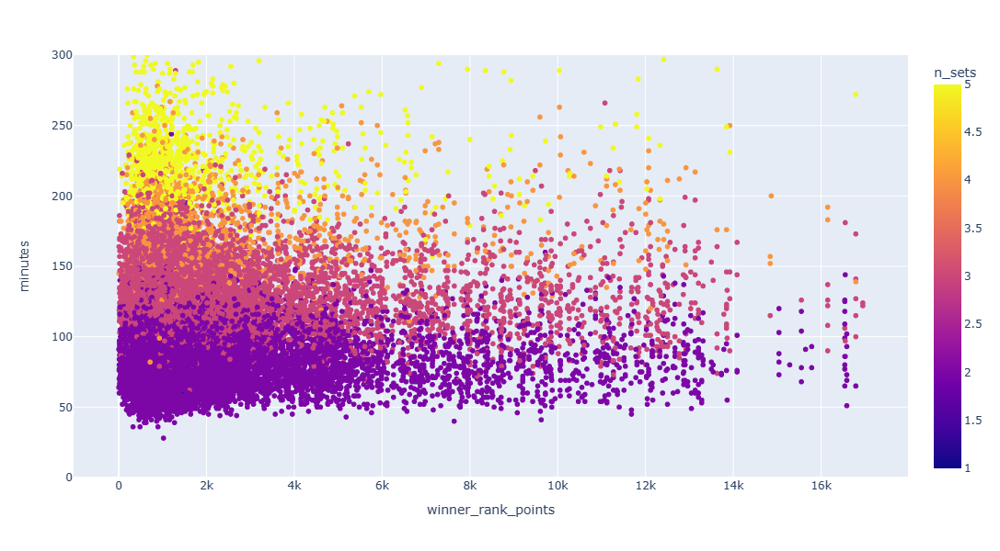

In [173]:
fig=px.scatter(d13,x='winner_rank_points',y='minutes',color='n_sets')
fig.update_layout(autosize=False,width=1000,height=600)
fig.update_yaxes(range=[0,300])

In [174]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='winner_rank_points',y='minutes',color='surface')
#fig.update_layout(autosize=False,width=1000,height=600)
#fig.update_yaxes(range=[0,300])

In [175]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#px.scatter(d13,x='winner_age',y='loser_age',color='n_sets')

In [176]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#px.scatter(d13,x='minutes',y='winner_age',color='n_sets')

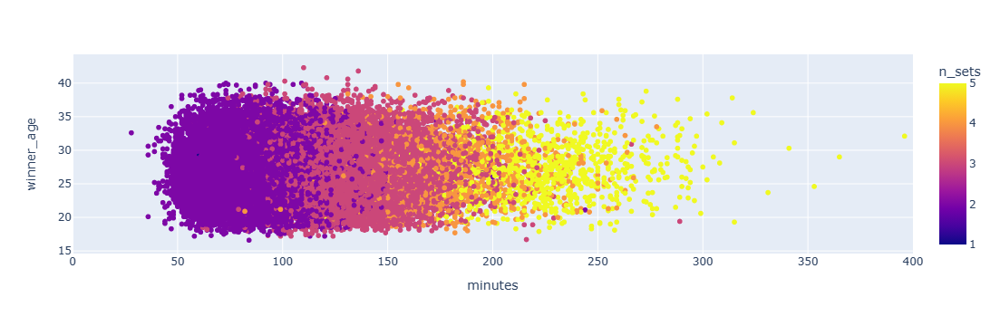

In [177]:
fig=px.scatter(d13,x='minutes',y='winner_age',color='n_sets')
fig.update_xaxes(range=[0,400])

In [178]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='minutes',y='winner_age',color='surface')
#fig.update_xaxes(range=[0,400])

In [179]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='winner_rank_points',y='loser_rank_points',color='n_sets')
#fig.update_layout(autosize=False,width=1000,height=1000)

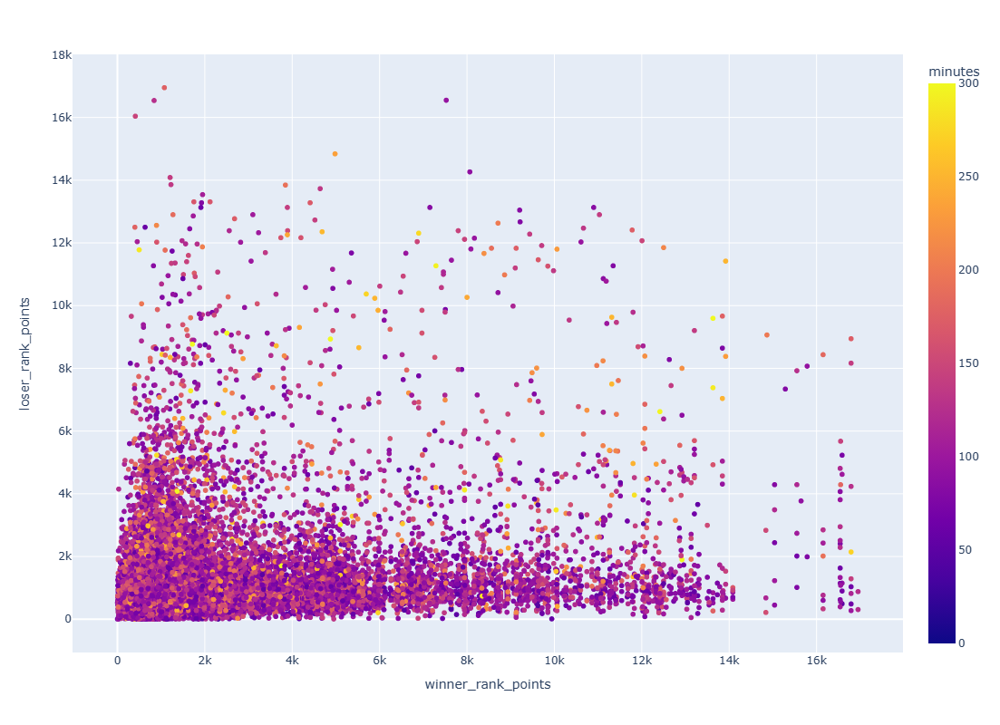

In [180]:
fig=px.scatter(d13,x='winner_rank_points',y='loser_rank_points',color='minutes',range_color=(0,300))
fig.update_layout(autosize=False,width=800,height=800)

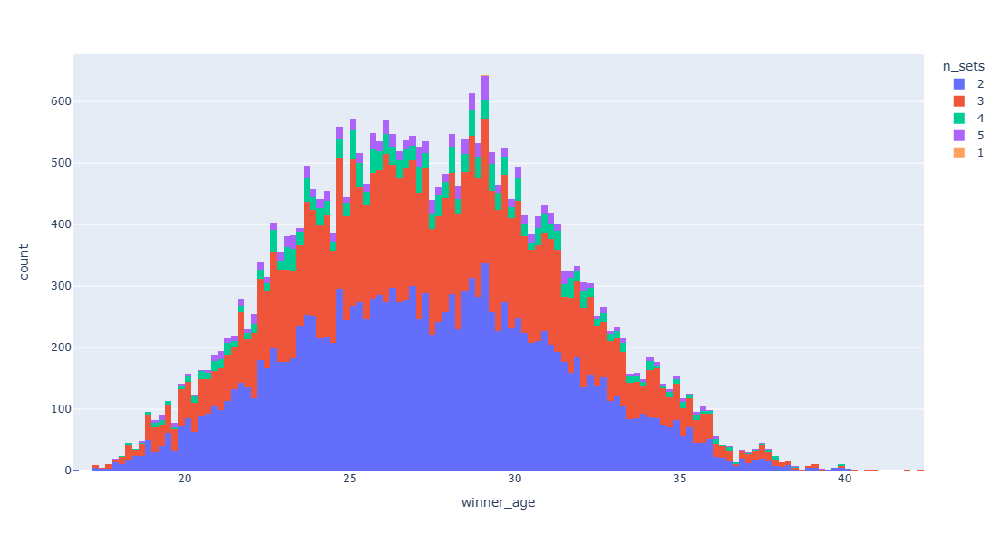

In [181]:
fig=px.histogram(d13,x='winner_age',color='n_sets')
fig.update_layout(autosize=False,width=800,height=600)

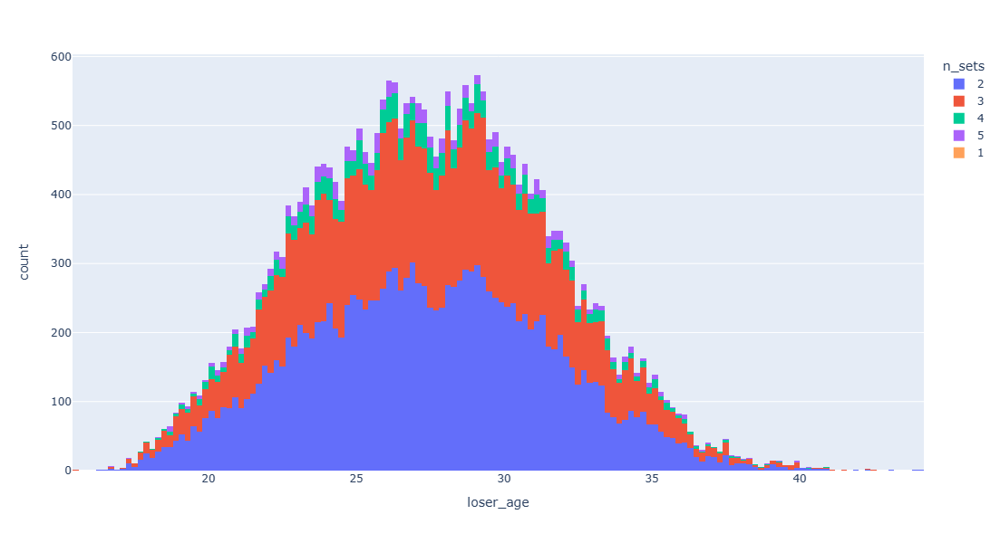

In [182]:
fig=px.histogram(d13,x='loser_age',color='n_sets')
fig.update_layout(autosize=False,width=800,height=600)

In [183]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='w_1stWon',y='l_1stWon',color='minutes',range_color=(0,400))
#fig.update_layout(autosize=False,width=700,height=700)
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

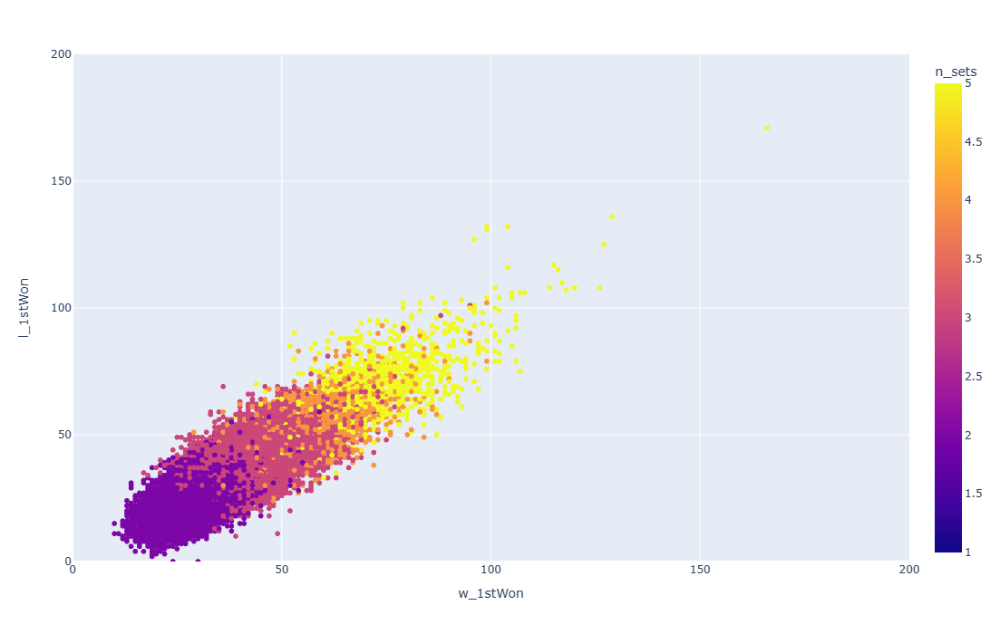

In [184]:
fig=px.scatter(d13,x='w_1stWon',y='l_1stWon',color='n_sets')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

In [185]:
# Removing the below chart to reduce file size (Github has a 25 MB maximum for file uploads) 

#fig=px.scatter(d13,x='w_1stWon',y='l_1stWon',color='winner_rank_points')
#fig.update_layout(autosize=False,width=700,height=700)
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

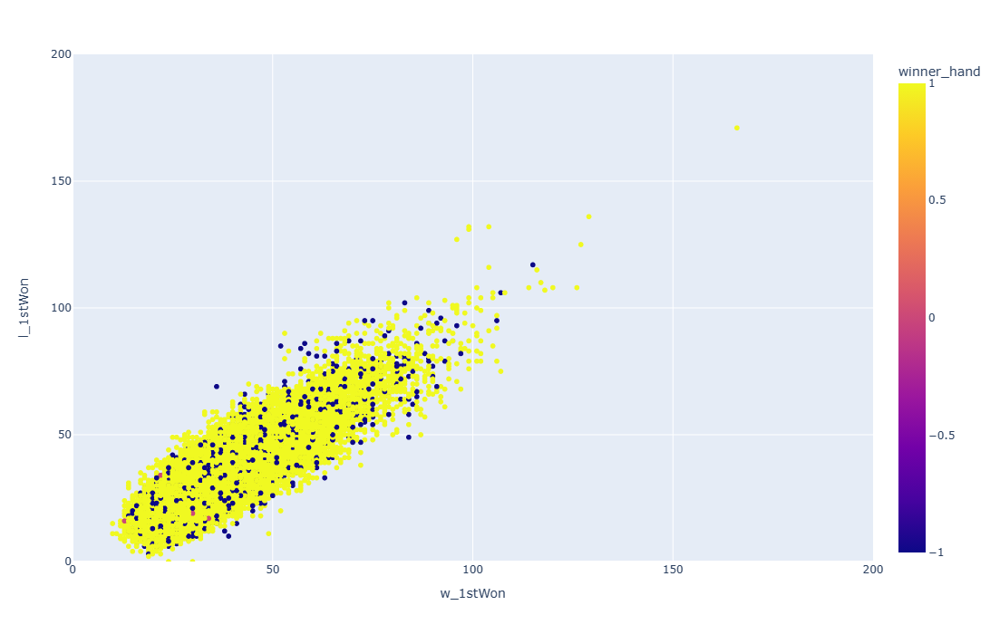

In [186]:
fig=px.scatter(d13,x='w_1stWon',y='l_1stWon',color='winner_hand')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

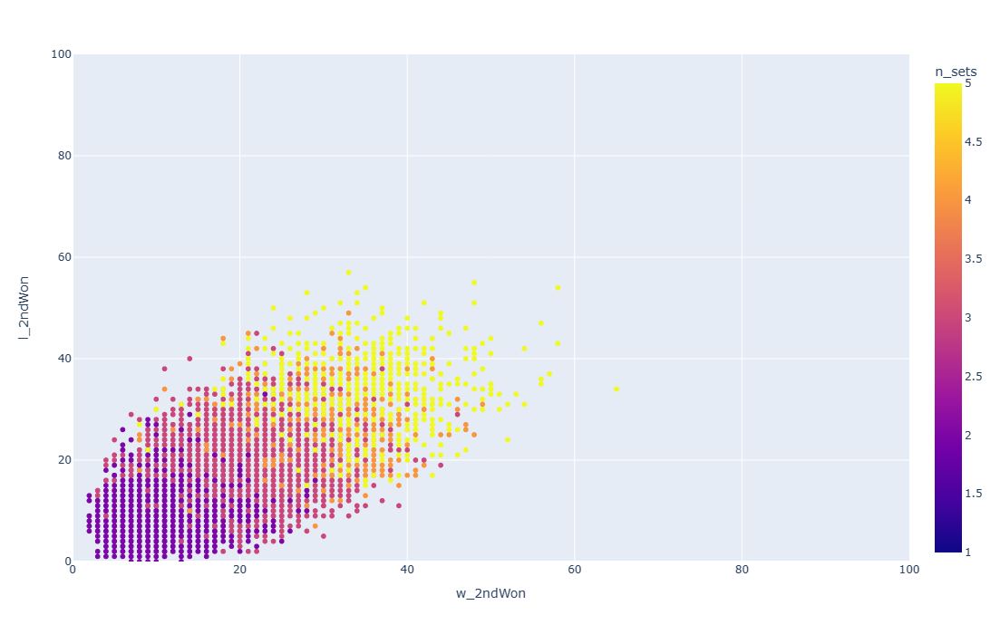

In [187]:
fig=px.scatter(d13,x='w_2ndWon',y='l_2ndWon',color='n_sets')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,100])
fig.update_yaxes(range=[0,100])

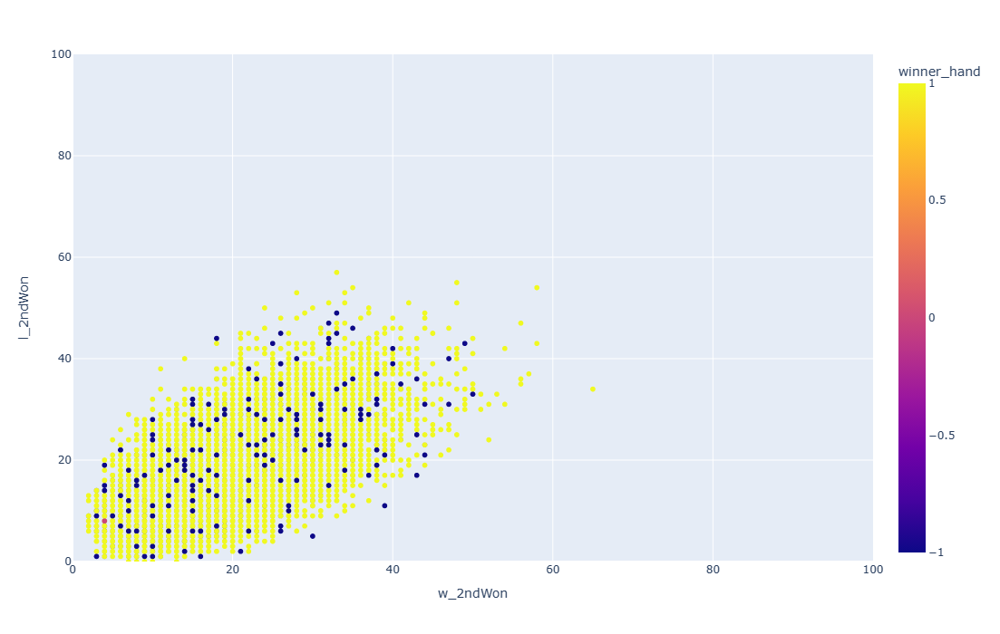

In [188]:
fig=px.scatter(d13,x='w_2ndWon',y='l_2ndWon',color='winner_hand')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,100])
fig.update_yaxes(range=[0,100])

In [189]:
# Investigate five-set matches to understand what sets the winnner apart from the loser

In [190]:
five_set=d13[d13['n_sets']==5]

In [191]:
five_set.shape

(1105, 36)

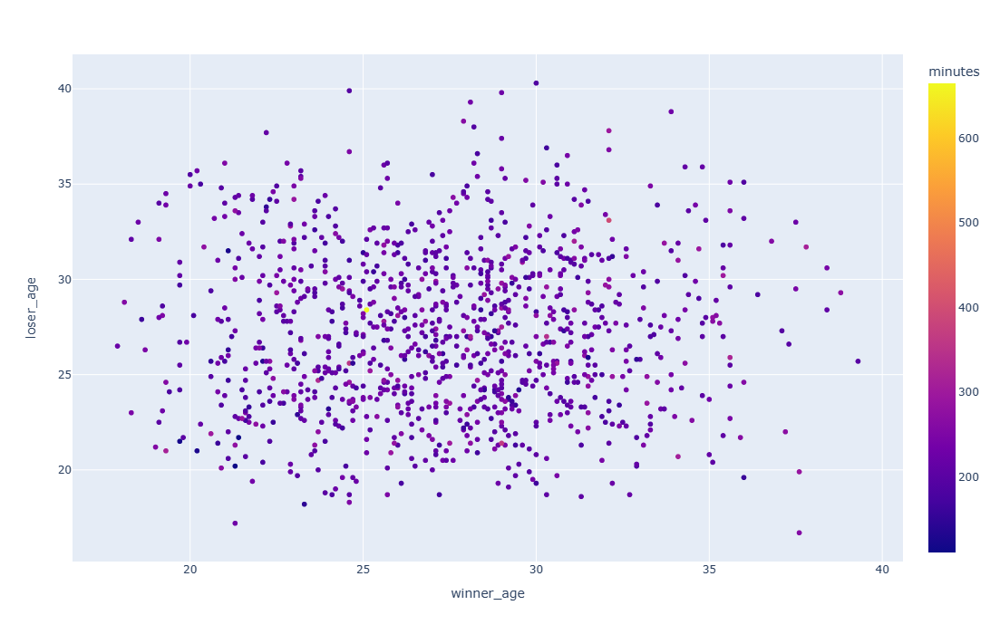

In [192]:
fig=px.scatter(five_set,x='winner_age',y='loser_age',color='minutes')
fig.update_layout(autosize=False,width=700,height=700)

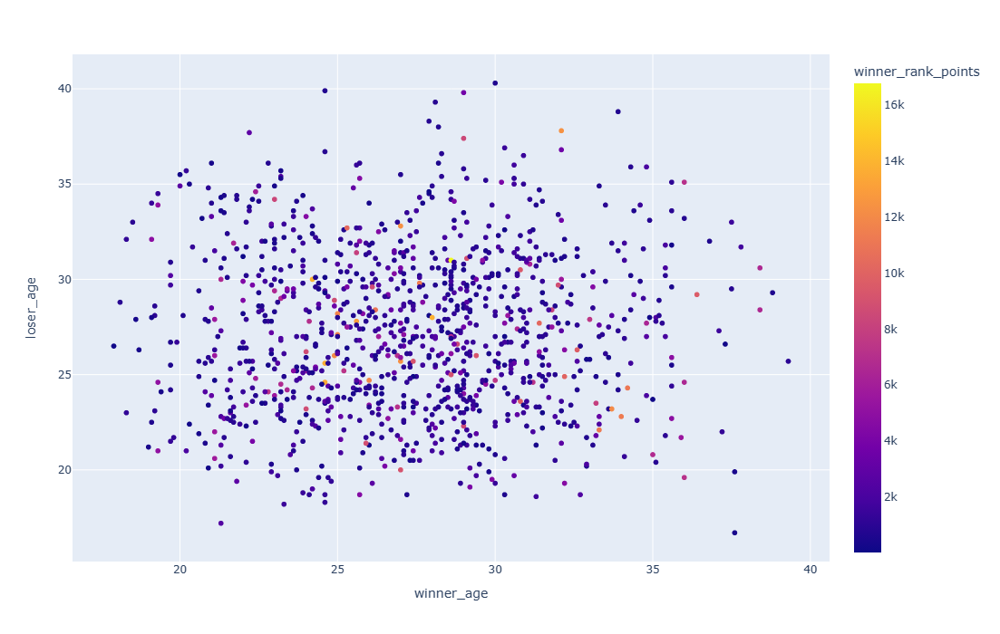

In [193]:
fig=px.scatter(five_set,x='winner_age',y='loser_age',color='winner_rank_points')
fig.update_layout(autosize=False,width=700,height=700)

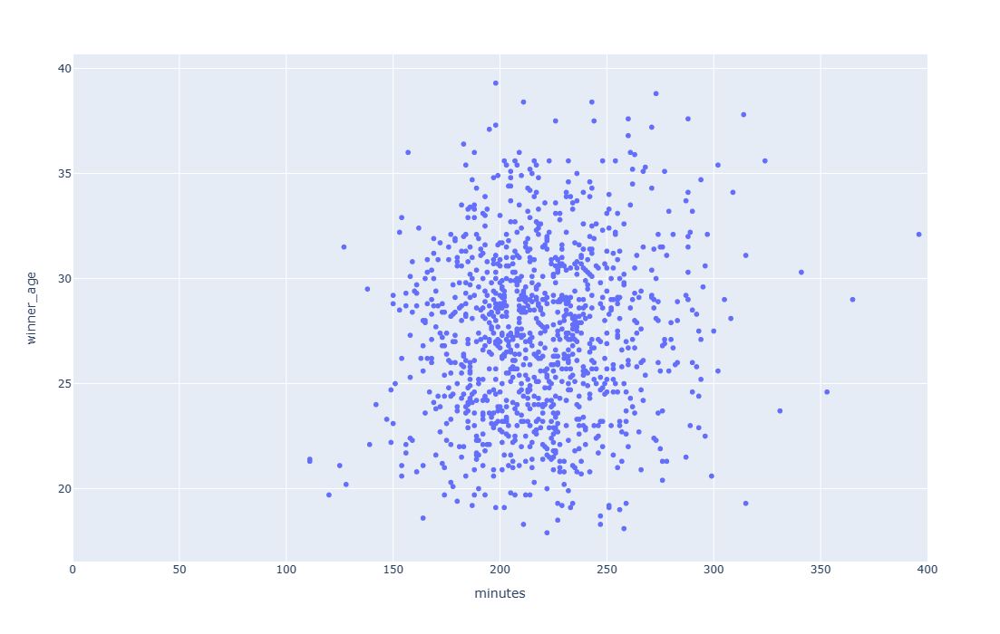

In [194]:
fig=px.scatter(five_set,x='minutes',y='winner_age')
fig.update_xaxes(range=[0,400])
fig.update_layout(autosize=False,width=700,height=700)

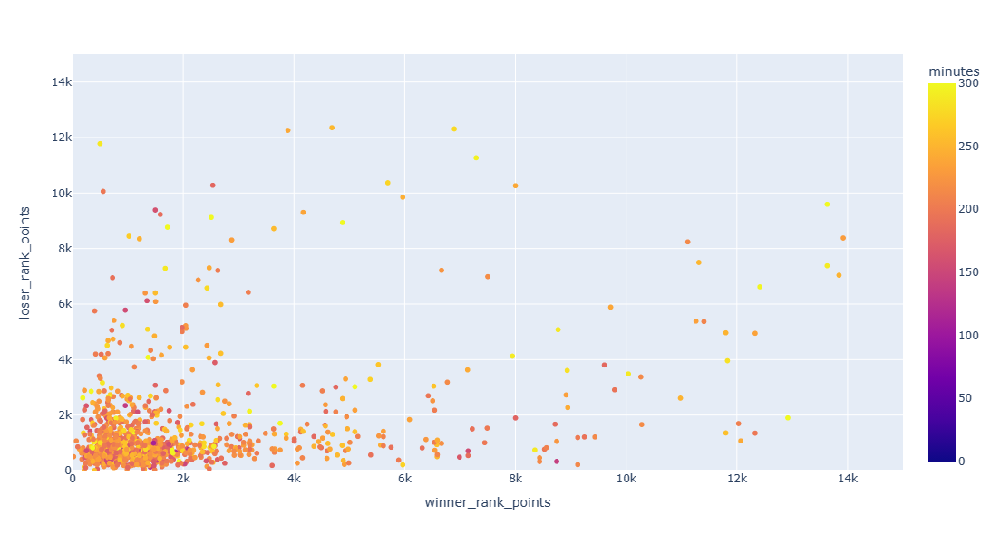

In [195]:
fig=px.scatter(five_set,x='winner_rank_points',y='loser_rank_points',color='minutes',range_color=(0,300))
fig.update_layout(autosize=False,width=600,height=600)
fig.update_xaxes(range=[0,15000])
fig.update_yaxes(range=[0,15000])

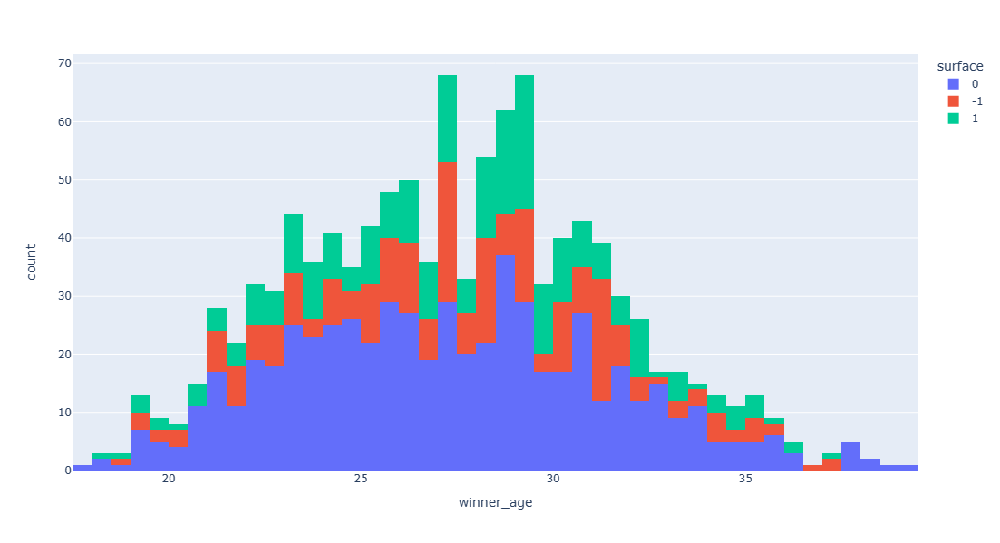

In [196]:
fig=px.histogram(five_set,x='winner_age',color='surface')
fig.update_layout(autosize=False,width=800,height=600)

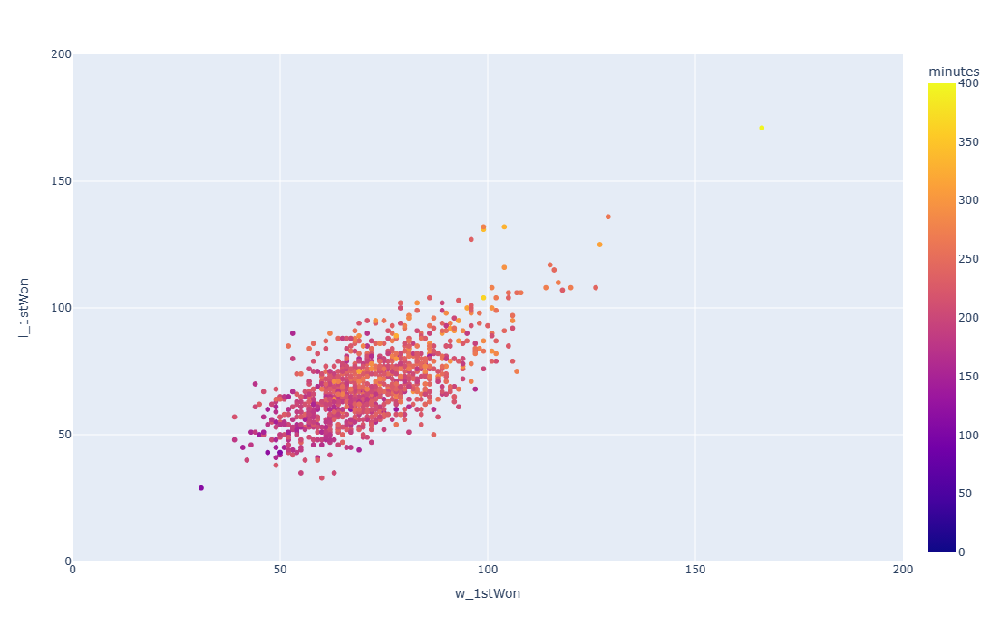

In [197]:
fig=px.scatter(five_set,x='w_1stWon',y='l_1stWon',color='minutes',range_color=(0,400))
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

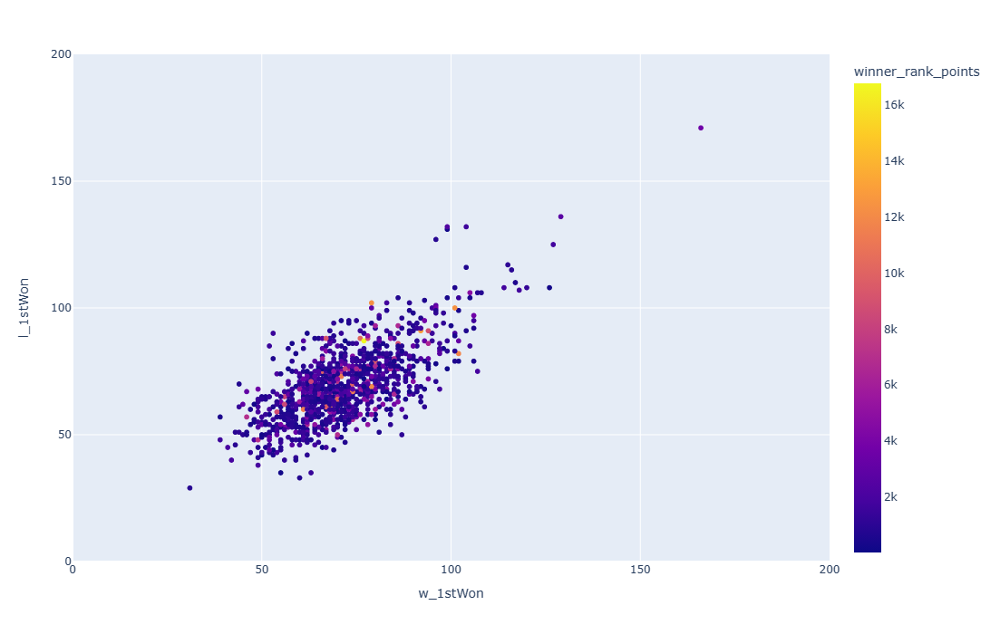

In [198]:
fig=px.scatter(five_set,x='w_1stWon',y='l_1stWon',color='winner_rank_points')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

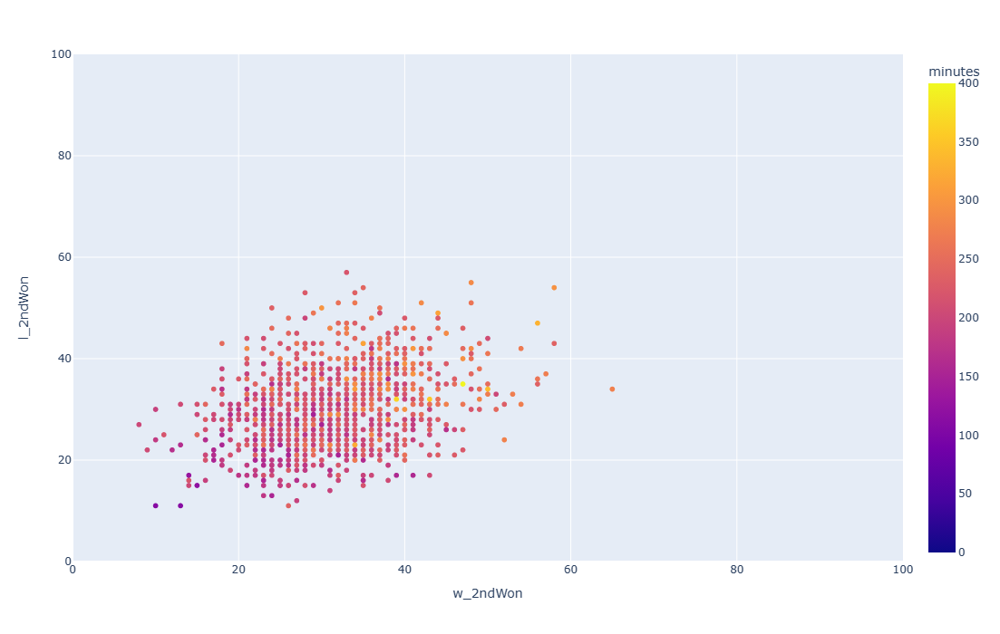

In [199]:
fig=px.scatter(five_set,x='w_2ndWon',y='l_2ndWon',color='minutes',range_color=(0,400))
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,100])
fig.update_yaxes(range=[0,100])

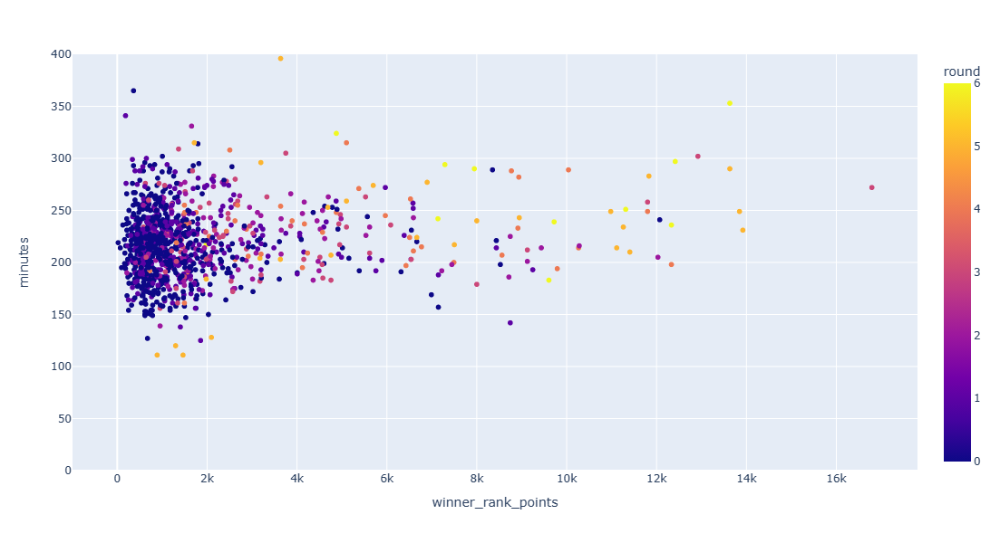

In [200]:
fig=px.scatter(five_set,x='winner_rank_points',y='minutes',color='round')
fig.update_layout(autosize=False,width=1000,height=600)
fig.update_yaxes(range=[0,400])

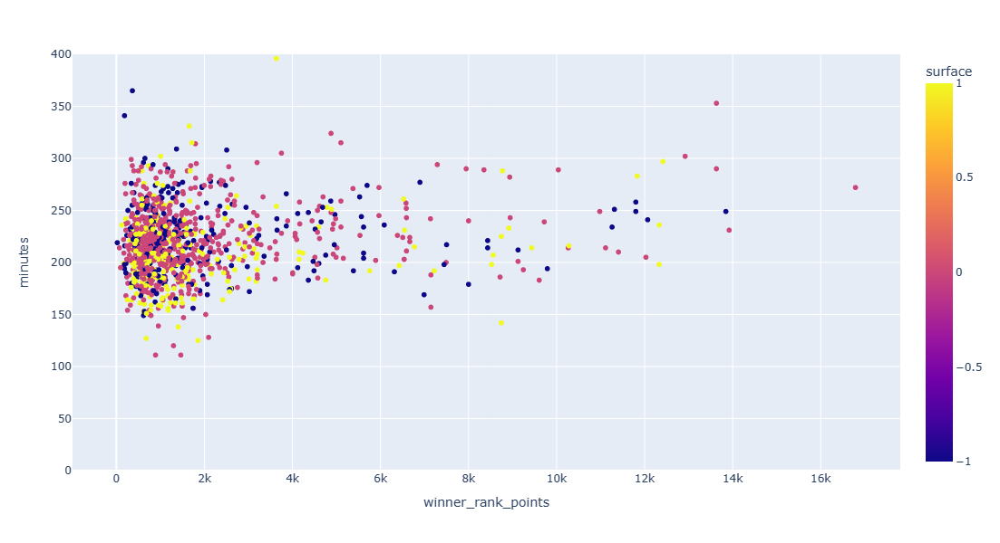

In [201]:
fig=px.scatter(five_set,x='winner_rank_points',y='minutes',color='surface')
fig.update_layout(autosize=False,width=1000,height=600)
fig.update_yaxes(range=[0,400])

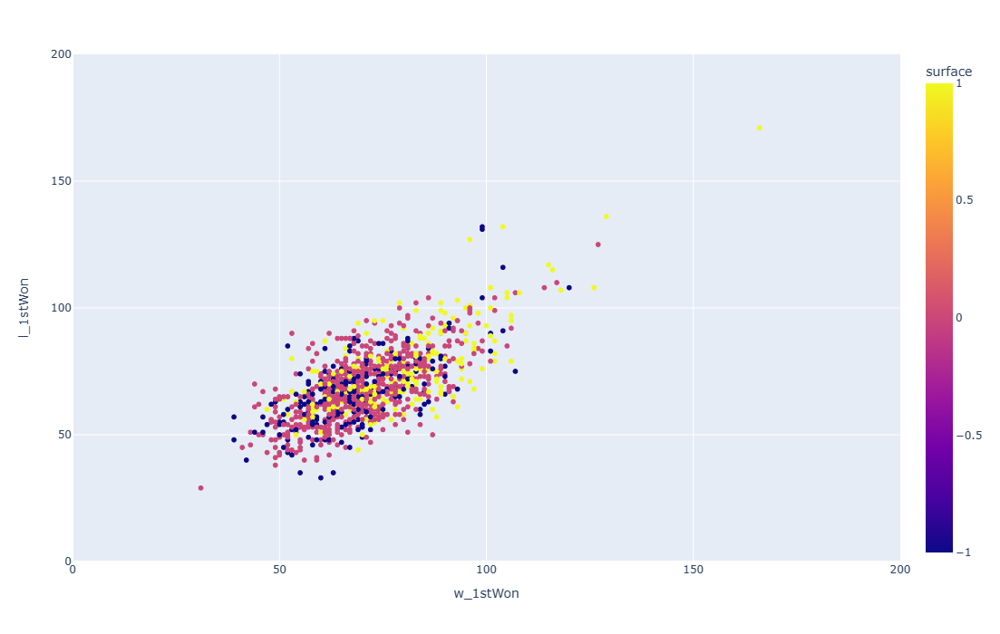

In [202]:
fig=px.scatter(five_set,x='w_1stWon',y='l_1stWon',color='surface')
fig.update_layout(autosize=False,width=700,height=700)
fig.update_xaxes(range=[0,200])
fig.update_yaxes(range=[0,200])

In [203]:
# Create additional metrics w_1stWonPerct and l_1stWonPerct, which measure how many first serve points were won as a 
# percentage of total number of serves for the winner and the loser, respectively. 
# Also create metrics w_bpLostPerct and l_bpLostPerct, which measure how many breakpoints while serving were lost as a 
# percentage of total number of serves for the winner and the loser, respectively 

five_set2=five_set.copy()

five_set2['w_1stWonPerct']=100*five_set2['w_1stWon']/five_set2['w_svpt']
five_set2['l_1stWonPerct']=100*five_set2['l_1stWon']/five_set2['l_svpt']

five_set2['w_2ndWonPerct']=100*five_set2['w_2ndWon']/five_set2['w_svpt']
five_set2['l_2ndWonPerct']=100*five_set2['l_2ndWon']/five_set2['l_svpt']

five_set2['w_bpLostPerct']=100*(five_set2['w_bpFaced']-five_set2['w_bpSaved'])/five_set2['w_svpt']
five_set2['l_bpLostPerct']=100*(five_set2['l_bpFaced']-five_set2['l_bpSaved'])/five_set2['l_svpt']

In [204]:
five_set2.head()

,surface,tourney_level,winner_hand,winner_ht,winner_age,loser_hand,loser_ht,loser_age,best_of,round,...,Player A ID,Player B ID,winner,n_sets,w_1stWonPerct,l_1stWonPerct,w_2ndWonPerct,l_2ndWonPerct,w_bpLostPerct,l_bpLostPerct
151809,0,3,-1,175.0,33.0,1,193.0,25.8,5,0,...,104330,102905,0,5,42.281879,40.645161,24.832215,20.645161,1.342282,3.225806
151810,0,3,1,183.0,25.0,1,183.0,29.9,5,0,...,104471,103507,1,5,40.441176,44.186047,18.382353,14.728682,3.676471,4.651163
151819,0,3,1,183.0,27.5,1,185.0,23.5,5,0,...,104022,104755,1,5,42.021277,45.251397,21.276596,16.759777,3.191489,3.351955
151827,0,3,1,183.0,24.4,1,185.0,29.5,5,0,...,104597,103598,1,5,44.970414,42.245989,23.076923,24.064171,2.366864,1.604278
151830,0,3,1,190.0,23.7,1,193.0,25.4,5,0,...,104719,104417,1,5,40.140845,41.139241,20.422535,17.721519,4.225352,4.430380


In [205]:
five_set2['w_1stWonPerct'].mean()

45.525958650131635

In [206]:
five_set2['l_1stWonPerct'].mean()

43.16635376083921

In [207]:
five_set2['w_bpLostPerct'].mean()

2.8101595656319507

In [208]:
five_set2['l_bpLostPerct'].mean()

3.7119947141547636

In [209]:
five_set2['w_2ndWonPerct'].mean()

19.76416300800698

In [210]:
five_set2['l_2ndWonPerct'].mean()

18.90593115221921

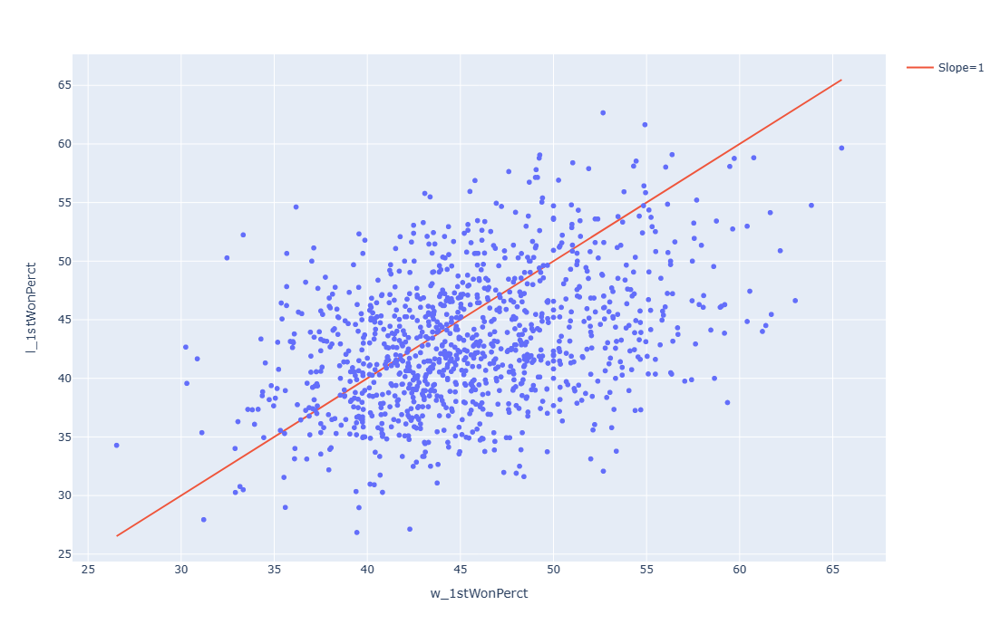

In [211]:
import plotly.graph_objects as go
fig=px.scatter(five_set2,x='w_1stWonPerct',y='l_1stWonPerct')
fig.update_layout(autosize=False,width=700,height=700)
fig.add_trace(go.Scatter(x=five_set2['w_1stWonPerct'], y=five_set2['w_1stWonPerct'],name='Slope=1',line_shape='linear'))
fig.show()
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

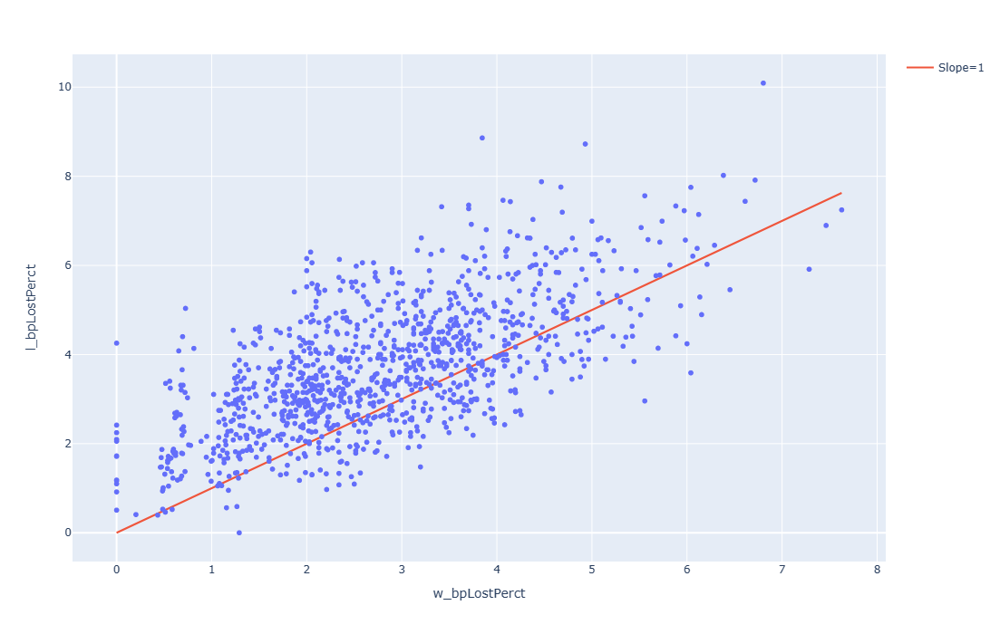

In [212]:

fig=px.scatter(five_set2,x='w_bpLostPerct',y='l_bpLostPerct')
fig.update_layout(autosize=False,width=700,height=700)
fig.add_trace(go.Scatter(x=five_set2['w_bpLostPerct'], y=five_set2['w_bpLostPerct'],name='Slope=1',line_shape='linear'))
fig.show()
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

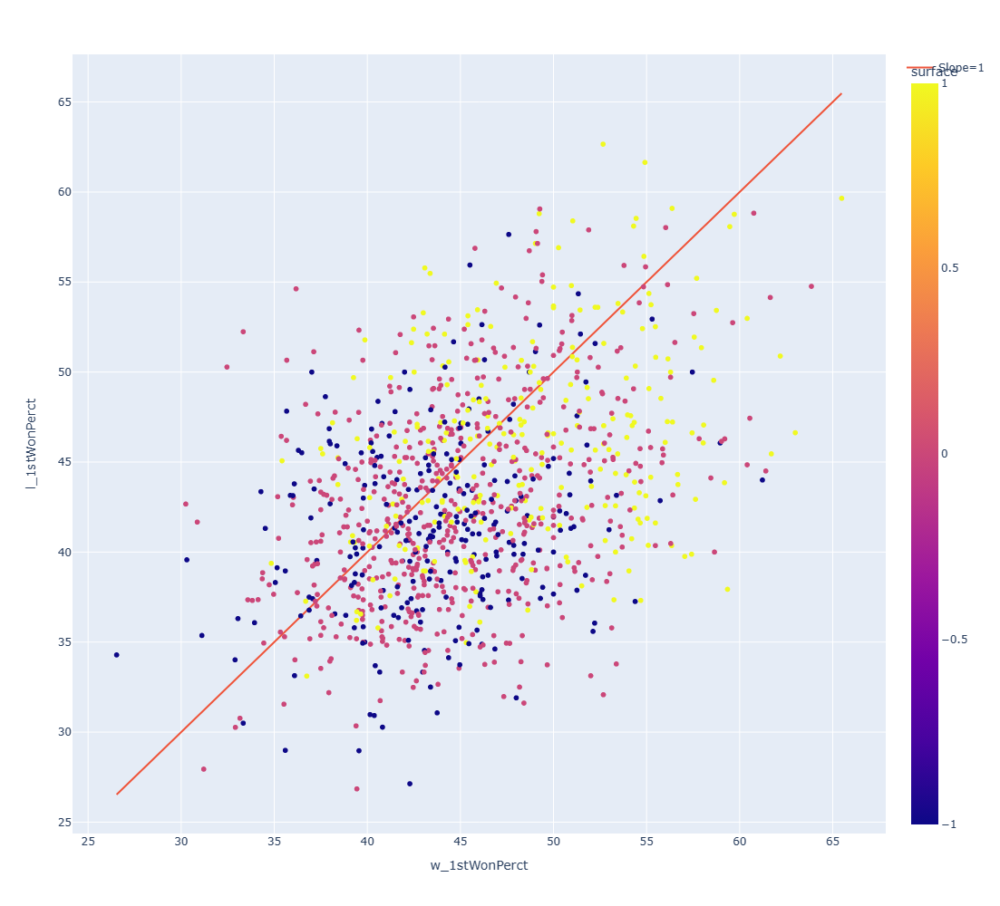

In [213]:
import plotly.graph_objects as go
fig=px.scatter(five_set2,x='w_1stWonPerct',y='l_1stWonPerct',color='surface')
fig.update_layout(autosize=False,width=1000,height=1000)
fig.add_trace(go.Scatter(x=five_set2['w_1stWonPerct'], y=five_set2['w_1stWonPerct'],name='Slope=1',line_shape='linear'))
fig.show()
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

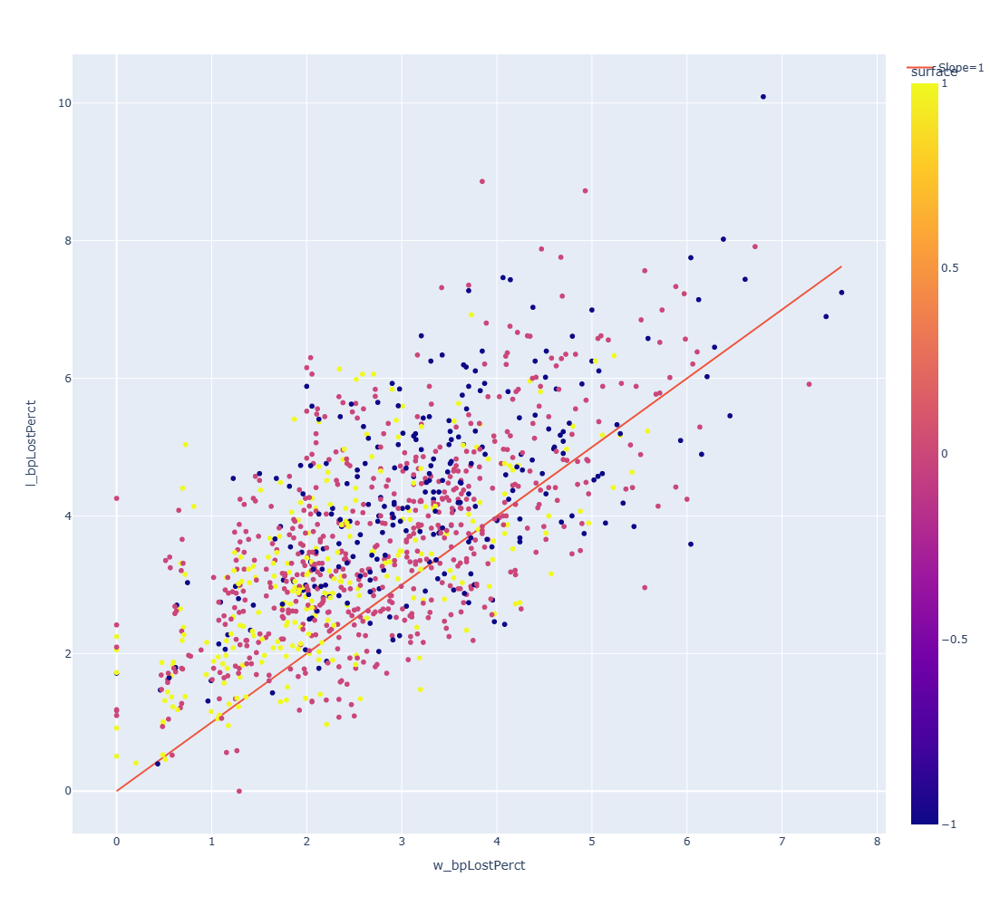

In [214]:
fig=px.scatter(five_set2,x='w_bpLostPerct',y='l_bpLostPerct',color='surface')
fig.update_layout(autosize=False,width=1000,height=1000)
fig.add_trace(go.Scatter(x=five_set2['w_bpLostPerct'], y=five_set2['w_bpLostPerct'],name='Slope=1',line_shape='linear'))
fig.show()

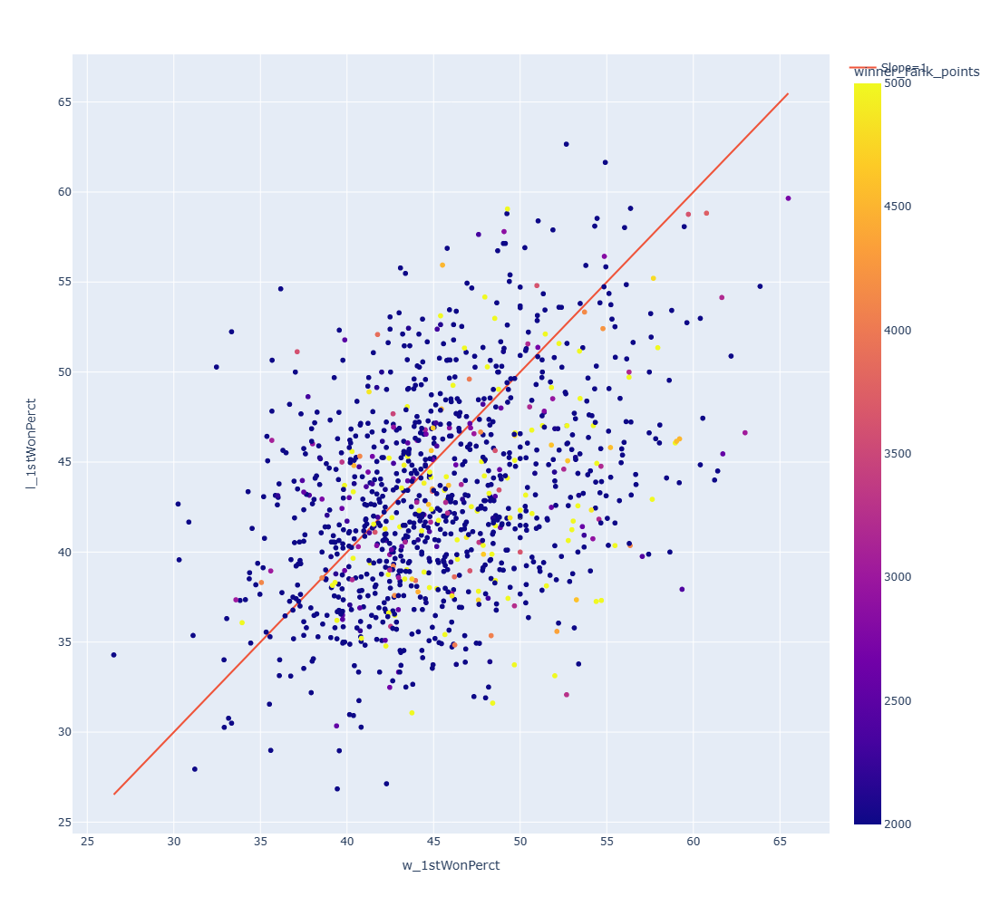

In [215]:
import plotly.graph_objects as go
fig=px.scatter(five_set2,x='w_1stWonPerct',y='l_1stWonPerct',color='winner_rank_points',range_color=(2000,5000))
fig.update_layout(autosize=False,width=1000,height=1000)
fig.add_trace(go.Scatter(x=five_set2['w_1stWonPerct'], y=five_set2['w_1stWonPerct'],name='Slope=1',line_shape='linear'))
fig.show()
#fig.update_xaxes(range=[0,200])
#fig.update_yaxes(range=[0,200])

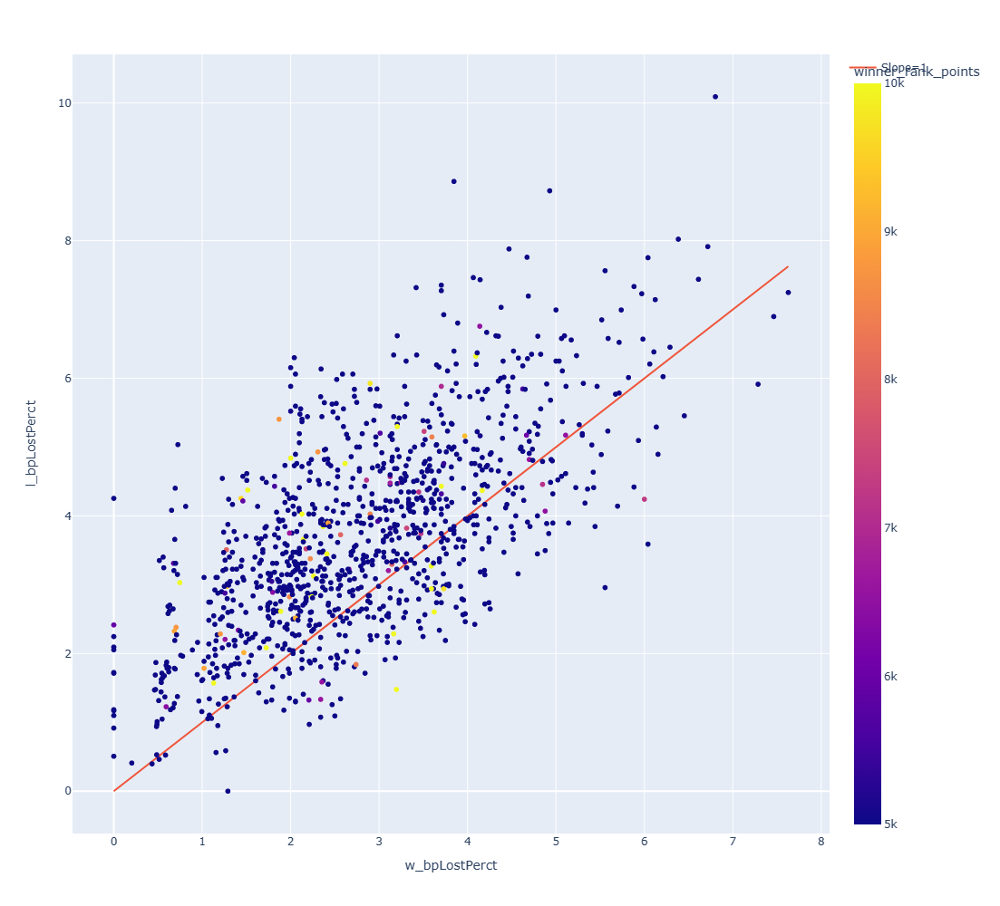

In [216]:
fig=px.scatter(five_set2,x='w_bpLostPerct',y='l_bpLostPerct',color='winner_rank_points',range_color=(5000,10000))
fig.update_layout(autosize=False,width=1000,height=1000)
fig.add_trace(go.Scatter(x=five_set2['w_bpLostPerct'], y=five_set2['w_bpLostPerct'],name='Slope=1',line_shape='linear'))
fig.show()